# Assignment 2

Link: https://github.com/AndreasRahbekPalm/CSS_assignments.git

Contributions: We have been collaburating equally on all of the parts.

by: Andreas Rahbek-Palm (s214598) and Valdemar Hee Hansen (s214621)

In [23]:
from copy import deepcopy
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import WordCloud
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import netwulf as nw
import community as community_louvain
import nltk
import math
import random
import json
import os

In [2]:
# Change the working directory
os.chdir('C:/Users/valde/OneDrive - Danmarks Tekniske Universitet/6. Semester/Computational Social Science/')


## Part 1: Properties of the real-world network of Computational Social Scientists

### 1. Random network

In [3]:
def generate_random_network(num_nodes: int, p: float):
    """"
    Function to generate a random network with a given number of nodes and edge probability p.
    
    Args:
        num_nodes: int, Number of nodes in the network
        p: float, Edge probability
        
    Returns:
        G_random: networkx graph object, Random network
    """
    
    # Create an empty graph
    G_random = nx.Graph()

    # Add nodes
    G_random.add_nodes_from(range(num_nodes))

    # Add edges
    for i in range(num_nodes):
        for j in range(i + 1, num_nodes):
            if np.random.uniform() < p:
                G_random.add_edge(i, j)

    return G_random

In [5]:
# Load the Computational Social Scientists network from json file
graph_dict = json.load(open('Week 4/graph.json'))
G = nx.node_link_graph(graph_dict)

# Compute the propability p for the Computational Social Scientists network
num_nodes = len(G.nodes)
num_edges = len(G.edges)
p = num_edges / (num_nodes * (num_nodes - 1) / 2)
print(f'The edge probability for the Computational Social Scientists network is {p}')

# Generate a random network with the same number of nodes and edge probability as the Computational Social Scientists network
G_random = generate_random_network(num_nodes, p)

The edge probability for the Computational Social Scientists network is 0.0005118876199173719


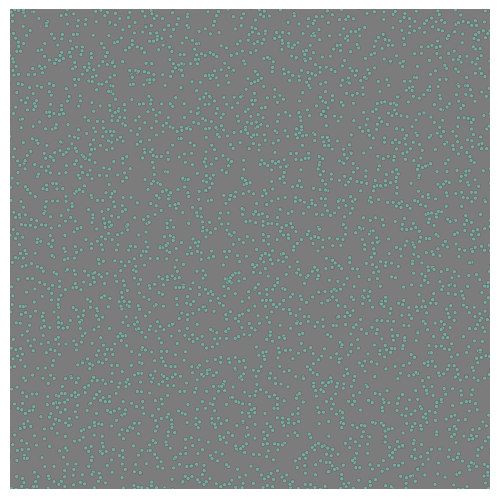

In [9]:
# Extract the largest connected component
largest_cc = max(nx.connected_components(G_random), key=len)
G_random_largest_cc = G_random.subgraph(largest_cc)

# Visualize the largest connected component of the Random Network
stylized_network, config = nw.visualize(G_random_largest_cc)

# Plot the network
fig, ax = nw.draw_netwulf(stylized_network)
plt.show()

#### Question:
Answer the following questions (max 200 words in total):

What regime does your random network fall into? Is it above or below the critical threshold?
According to the textbook, what does the network's structure resemble in this regime?
Based on your visualizations, identify the key differences between the actual and the random networks. Explain whether these differences are consistent with theoretical expectations.

#### Answer:

As the average degree is 6.3, it hereby, exceeds the critical value we conclude it has a giant component, however, it is below the logarithm to the number of nodes. We can therefore conclude the random network falls into the super-critical regime. 


A super-critical regime is the network structure resembled by it having a giant component but isn’t fully connected therefore small isolated components. Small components have tree-like structures while the giant component contains nodes connected in loops or circles. 


There are large differences between the highest degree of a node in the random network and the real-world network. this is due to the real-life network not being Poisson which is the distribution that best approximates a random network of this size. For Poisson distrutions the difference between the max and min number of degrees is small, unlike our real-world network which has vast maximum degrees for a node. This is due to Poisson not being able to capture outliers. 


In [10]:
degree_random = dict(G_random.degree())
degree = dict(G.degree())

avarage_degree_random = np.mean(list(degree_random.values()))
avarage_degree = np.mean(list(degree.values()))

print(f'The average degree of the Computational Social Scientists network is {avarage_degree}')
print(f'The average degree of the Random Network is {avarage_degree_random}')

max_degree_random = max(degree_random, key=degree_random.get)
max_degree = max(degree, key=degree.get)

print(f'The node with the highest degree in the Computational Social Scientists network is {max_degree} with a degree of {degree[max_degree]}')
print(f'The node with the highest degree in the Random Network is {max_degree_random} with a degree of {degree_random[max_degree_random]}')

The average degree of the Computational Social Scientists network is 6.294682062123923
The average degree of the Random Network is 6.312571149780452
The node with the highest degree in the Computational Social Scientists network is https://openalex.org/A5075080019 with a degree of 169
The node with the highest degree in the Random Network is 8806 with a degree of 19


### 2. Degree distribution

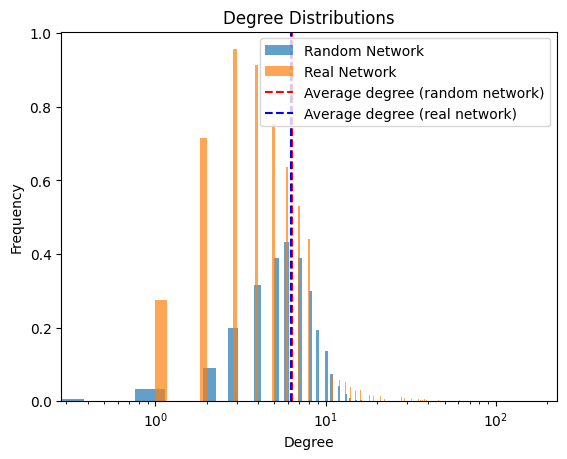

In [11]:
# Compute the degree distribution for the Computational Social Scientists network
degrees_real = [degree for node, degree in G.degree()]

# Compute the degree distribution for the random network
degrees_random = [degree for node, degree in G_random.degree()]

# Plot the degree distributions
plt.figure()
plt.hist(degrees_random, bins=50, density=True, alpha=0.7, label='Random Network')
plt.hist(degrees_real, bins=1000, density=True, alpha=0.7, label='Real Network')

# Add vertical lines for the average degrees
plt.axvline(np.mean(degrees_random), color='r', linestyle='--', label='Average degree (random network)')
plt.axvline(np.mean(degrees_real), color='b', linestyle='--', label='Average degree (real network)')

# log scale the x-axis
plt.xscale('log')
plt.legend()
plt.title('Degree Distributions')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.show()

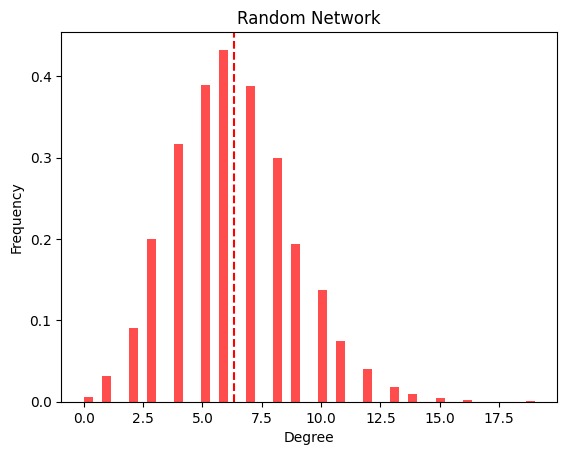

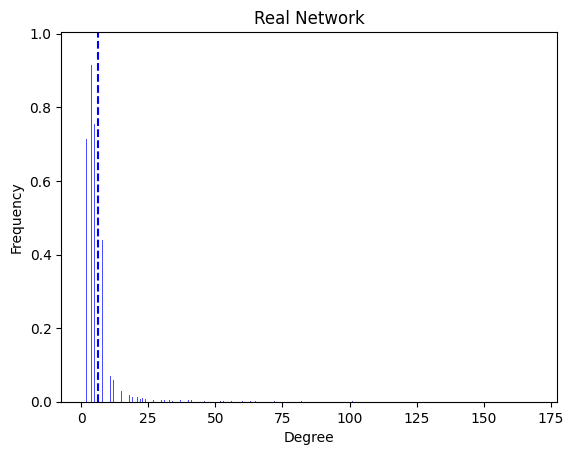

In [12]:
plt.figure()
plt.hist(degrees_random, bins=50, density=True, alpha=0.7, color='r')
plt.axvline(np.mean(degrees_random), color='r', linestyle='--')
plt.title('Random Network')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.show()

# Plot the degree distribution for the real network
plt.figure()
plt.hist(degrees_real, bins=1000, density=True, alpha=0.7, color='b')
plt.axvline(np.mean(degrees_real), color='b', linestyle='--')
plt.title('Real Network')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.show()

#### Question:

Answer the following questions (max 200 words in total):
Does the average degree meaningfully represents the network's characteristics, especially in light of the insights gained from exploring heavy-tailed distributions? Discuss its adequacy or limitations in capturing the essence of the network's structural properties.
What differences can you observe between the real and the random distributions? How does the shape of the degree distribution for each network inform us about the network's properties? 

#### Answer:

The average degree doesn't represent any real network characteristics other than if we can expect to have a giant component. We see this as the average degree is roughly the same between the real-world network and the random network, however, the general structure of the network differs greatly. This is due to our scientist network following a heavy tail distribution, which is due to having a proportion of nodes with a lot of connections. As heavy tail distributions are very screwed, by only considering the average degree we do not capture heterogeneity tendencies in the network, as nodes disproportionately influence the network. We therefore overlook nuances of the structure like hubs. assortativity or clustering coefficients can also bring valuable insights into the network structure.
 
the random network follows approximately a Poisson distribution and the real-world network follows a heavy tail distribution by having significant mass in the tail thereby making it screwed. Hereby we see that we in the random network dont encounter these hubs where a node has an extremely high amount of edges. The opposite is the case for heavy tail distributed degrees, as we here have nodes with a significantly higher amount of connections than the average. 


## Part 2 Network Analysis in Computational Social Science

### Exercise 1: Mixing Patterns and Assortativity

In [13]:
def assortativity_coefficient(G: nx.Graph, attribute: str):
    """
    Function to calculate the degree assortativity coefficient for a given network.

    Args:
        G: nx.Graph, Network to consider
    
    Returns:
        r: float, Degree assortativity coefficient
    """
    
    # Get the degrees of the nodes in the graph
    degrees = {node: degree for node, degree in G.degree()}

    # Get the edge list of the graph
    edge_list = list(G.edges)

    # Get the values of the attribute for each node
    values = nx.get_node_attributes(G, attribute)

    # Create a list of tuples with the degree of the node and the value of the attribute
    degree_value = [(values[key], value) for key, value in degrees.items()]

    # Create a list edges between nodes with the same attribute value
    edges = [(values[edge[0]], 1) for edge in edge_list if values[edge[0]] == values[edge[1]]]

    # Create a dataframe for the edges list
    df_edge = pd.DataFrame(edges, columns=[attribute, 'num_edges'])

    # Compute the number of edges between nodes with the same attribute value
    df_edge = df_edge.groupby(attribute).sum()

    # Create a dataframe from the list of tuples
    df_degree = pd.DataFrame(degree_value, columns=[attribute, 'degree'])

    # Calculate the number of edges between nodes with the same attribute value
    df_degree = df_degree.groupby(attribute).sum()

    # Merge the two dataframes
    df = pd.concat([df_degree, df_edge], axis=1)

    # Fill NaN values with 0
    df = df.fillna(0)

    # Divide each column by the sum of the column
    df['num_edges'] = df['num_edges'] / len(edge_list)
    df['degree'] = df['degree'] / sum(degrees.values())

    # Calculate the degree assortativity coefficient
    r = (df['num_edges'].sum() - df['degree'].pow(2).sum()) / (1 - df['degree'].pow(2).sum())

    return r

In [14]:
# Calculate the degree assortativity of the original network
degree_assortativity = assortativity_coefficient(G, 'country_code')
print("Degree Assortativity of Original Network:", degree_assortativity)

Degree Assortativity of Original Network: 0.4150460386794204


In [15]:
def configuration_model(G: nx.Graph, num_swaps: int):
    """
    Function to generate a configuration model of a given network.

    Args:
        G: nx.Graph, Network to consider
        num_swaps: int, Number of edge swaps to perform
    
    Returns:
        G_new: nx.Graph, Configuration model of the network
    """
    
    # Create an exact copy of the original network
    G_new = deepcopy(G)

    # Create a list of edges and a dictionary of edges for faster lookup
    edges_dict = dict(G_new.edges())
    edges = list(edges_dict.keys())

    swaps = 0
    while swaps < num_swaps:
        # Select two edges
        edges = random.sample(edges, 2)
        e1, e2 = edges[0], edges[1]
        
        # Ensure u != y and v != x
        if e1[0] != e2[1] or e1[1] != e2[0]:

            # Flip the direction of e1 50% of the time
            e1_original = e1
            if random.randint(0, 1) < 0.5:
                e1 = (e1[1], e1[0])

            # Create new edges
            e1_new = (e1[0], e2[1])
            e2_new = (e2[0], e1[1])

            # Check if the new edges already exist in the network
            if edges_dict.get(e1_new) is None and edges_dict.get(e2_new) is None:
                # Remove the old edges and add the new edges
                edges_dict.pop(e1_original)
                edges_dict.pop(e2)
                edges_dict[e1_new] = 1
                edges_dict[e2_new] = 1
                edges.pop(edges.index(e1_original))
                edges.pop(edges.index(e2))
                edges.append(e1_new)
                edges.append(e2_new)
                G_new.remove_edge(*e1_original)
                G_new.remove_edge(*e2)
                G_new.add_edge(*e1_new)
                G_new.add_edge(*e2_new)

                swaps += 1

    return G_new

100%|██████████| 100/100 [04:36<00:00,  2.77s/it]


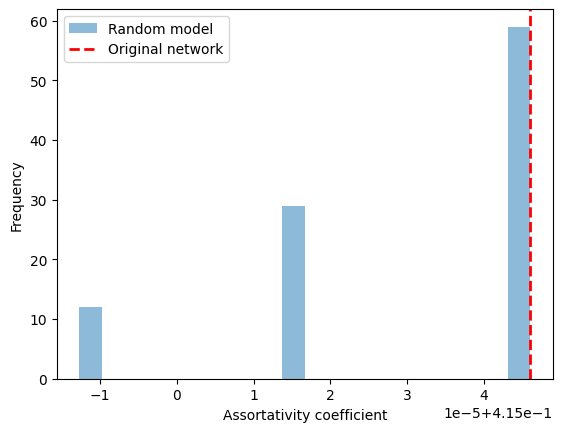

In [16]:
# Calculate the fraction of edges in the new network that connect nodes from the same country
num_edges = G.number_of_edges()
num_networks = 100
assortativity_config = []

for _ in tqdm(range(num_networks)):
    # Generate a random network using the configuration model
    G_config = configuration_model(G, num_edges * 10)

    # Calculate the assortativity of the random network
    assortativity = assortativity_coefficient(G_config, 'country_code')
    assortativity_config.append(assortativity)

# Plot the distribution of assortativity values
plt.hist(assortativity_config, bins=20, alpha=0.5, label='Random model')
plt.axvline(assortativity_coefficient(G, 'country_code'), color='r', linestyle='dashed', linewidth=2, label='Original network')
plt.xlabel('Assortativity coefficient')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [17]:
def degree_assortativity_coefficient(G: nx.Graph):
    """
    Function to calculate the degree assortativity coefficient for a given network.

    Args:
        G: nx.Graph, Network to consider
    
    Returns:
        r: float, Degree assortativity coefficient
    """
    
    # Get all edges
    edges = list(G.edges)

    # Get all u and v values
    u_values, v_values = zip(*edges)

    # Get all degrees
    degrees = dict(G.degree())

    # Get the degree of u and v
    k_u = np.array([degrees[u] for u in u_values])
    k_v = np.array([degrees[v] for v in v_values])

    # Calculate the degree assortativity coefficient
    # r = (np.average(list(degrees.values())) - np.average(k_u) * np.average(k_v)) / (np.sqrt(np.average(k_u ** 2) - np.average(k_u) ** 2) * np.sqrt(np.average(k_v ** 2) - np.average(k_v) ** 2))
    r = (np.mean(k_u * k_v) - np.mean(k_u) * np.mean(k_v)) / (np.sqrt(np.mean(k_u ** 2) - np.mean(k_u) ** 2) * np.sqrt(np.mean(k_v ** 2) - np.mean(k_v) ** 2))

    return r


# Calculate the degree assortativity coefficient of the original network
degree_assortativity = degree_assortativity_coefficient(G)
true_degree_assortativity = nx.degree_assortativity_coefficient(G)
print("Degree assortativity of original network:", degree_assortativity)
print("True degree assortativity of original network:", true_degree_assortativity)

Degree assortativity of original network: 0.014212078841032873
True degree assortativity of original network: -0.112960410365673


  0%|          | 0/100 [00:00<?, ?it/s]

100%|██████████| 100/100 [04:39<00:00,  2.80s/it]


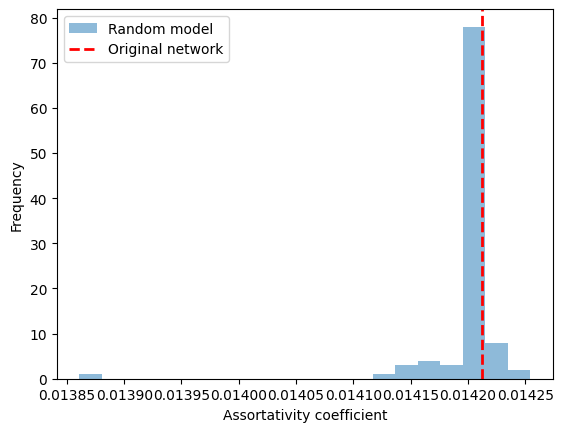

In [18]:
# Calculate the fraction of edges in the new network that connect nodes from the same country
num_edges = G.number_of_edges()
num_networks = 100
degree_assortativity_config = []

for _ in tqdm(range(num_networks)):
    # Generate a random network using the configuration model
    G_config = configuration_model(G, num_edges * 10)

    # Calculate the assortativity of the random network
    degree_assortativity = degree_assortativity_coefficient(G_config)
    degree_assortativity_config.append(degree_assortativity)

# Plot the distribution of assortativity values
plt.hist(degree_assortativity_config, bins=20, alpha=0.5, label='Random model')
plt.axvline(degree_assortativity_coefficient(G), color='r', linestyle='dashed', linewidth=2, label='Original network')
plt.xlabel('Assortativity coefficient')
plt.ylabel('Frequency')
plt.legend()
plt.show()

#### Question:

7. Assortativity by degree. Were the results of the degree assortativity in line with your expectations? Why or why not?
8. Edge flipping. In the process of implementing the configuration model, you were instructed to flip the edges (e.g., changing e_1 from (u,v) to (v,u)) 50% of the time. Why do you think this step is included?
9. Distribution of assortativity in random networks. Describe the distribution of degree assortativity values you observed for the random networks. Was the distribution pattern expected? Discuss how the nature of random network generation (specifically, the configuration model and edge flipping) might influence this distribution and whether it aligns with theoretical expectations.


#### Answer:

We calculated the Assortativity by degree of the social scientist network to be around 0 which we expected due to some of these mass collaborators collaborating but they also might function as mentors for upcoming researchers or students hereby they collaborate with a very diverse group. 


Without edge flipping, the configuration model may introduce biases based on the order in which edges are assigned. As edges might be sorted when building edges in the graph some nodes would then be more likely to be connected to others as they are likely placed in the u or v position of an edge. As we only connect u with y and v with x sorted edges would introduce bias. Edge flipping helps mitigate these biases by ensuring that edges are distributed more evenly among nodes.


the distribution of the assortativity in the random networks seems to approximate a rather narrow Gaussian distribution around the true network. This is expected as for random networks it is typical to be close to 0 as the original is, since when we create the configuration model we eagle swap randomly and don't allow self-loops and multiple links between nodes. 


### Excercise 2: Central nodes

In [19]:
# Assuming G is your NetworkX graph
closeness = nx.closeness_centrality(G)

# Sort the nodes by closeness centrality
sorted_closeness = sorted(closeness.items(), key=lambda x: x[1], reverse=True)

# Get the 5 most central nodes
most_central_nodes = [node for node, centrality in sorted_closeness[:5]]

print(most_central_nodes)

['https://openalex.org/A5021346979', 'https://openalex.org/A5015080044', 'https://openalex.org/A5048877432', 'https://openalex.org/A5084282503', 'https://openalex.org/A5031799782']


In [20]:
# Assuming G is your NetworkX graph
eigenvector = nx.eigenvector_centrality(G)

# Sort the nodes by eigenvector centrality
sorted_eigenvector = sorted(eigenvector.items(), key=lambda x: x[1], reverse=True)

# Get the 5 most central nodes
most_central_nodes = [node for node, centrality in sorted_eigenvector[:5]]

print(most_central_nodes)

['https://openalex.org/A5021346979', 'https://openalex.org/A5031799782', 'https://openalex.org/A5046546654', 'https://openalex.org/A5014662127', 'https://openalex.org/A5069885186']


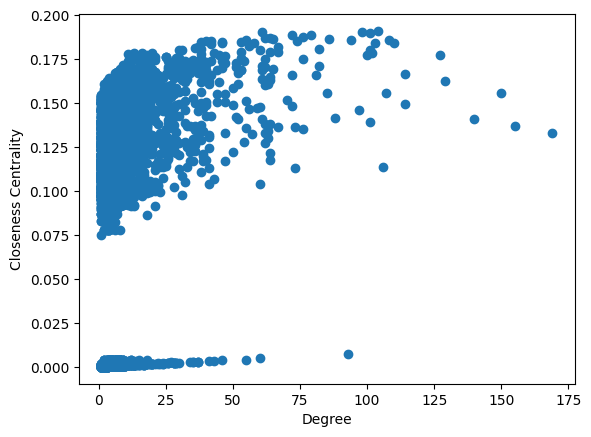

In [21]:
closeness = nx.closeness_centrality(G)
degree = dict(G.degree())

# Get the degree and closeness centrality values
degrees = [degree[node] for node in G.nodes()]
closeness_centralities = [closeness[node] for node in G.nodes()]

# Create the plot
plt.scatter(degrees, closeness_centralities)
plt.xlabel('Degree')
plt.ylabel('Closeness Centrality')
plt.show()

#### Question:


Plot the closeness centrality of nodes vs their degree. Is there a correlation between the two? Did you expect that? Why?

#### Answer:

yes, it is expected as the graph is not fully connected so the few components that are not in the giant component have very little value. We expected a stronger correlation due to hubs having a small average distance to all nodes is expected to be lower, however, it still illustrates some sort of correlation.


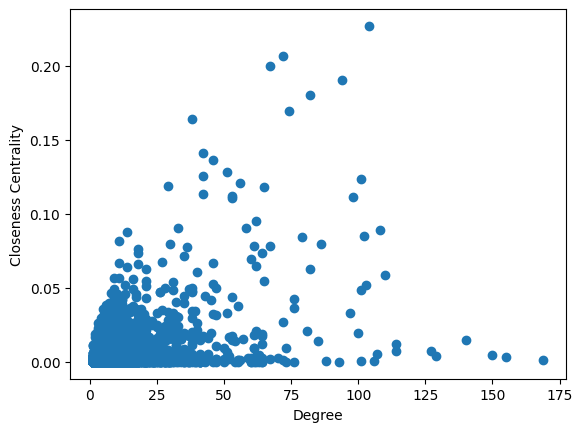

In [22]:
closeness = nx.eigenvector_centrality(G)
degree = dict(G.degree())

# Get the degree and closeness centrality values
degrees = [degree[node] for node in G.nodes()]
eigenvector_centrality = [closeness[node] for node in G.nodes()]

# Create the plot
plt.scatter(degrees, eigenvector_centrality)
plt.xlabel('Degree')
plt.ylabel('Closeness Centrality')
plt.show()

#### Question:

Repeat the two points above using eigenvector centrality instead. Do you observe any difference? Why?

#### Answer:

we observe some of the nodes with extreme degree gets low scores, this could be due to them being connected to a lot of low-degree nodes, which we know based on the assortativity score. However, in general, there is a positive correlation which indicates some of these hubs are connected.

## Part 3 - Words that characterize Computational Social Science communities

### Exercise 1: TF-IDF and the Computational Social Science communities

TF stands for Term Frequency. It measures how frequently a term occurs in a document.
IDF stands for Inverse Document Frequency. It measures how important a term is. While computing TF, all terms are considered equally important. However, certain terms, such as "is", "of", and "that", may appear a lot of times but have little importance. Thus we need to weigh down the frequent terms while scaling up the rare ones, by computing the following: 
\begin{align}
\text{TF-IDF} = \text{TF} \times \text{IDF}
\end{align}
where,
\begin{align}
\text{TF} = \frac{\text{Number of times term t appears in a document}}{\text{Total number of terms in the document}} \\ 
\text{IDF} = \log\left(\frac{\text{Total number of documents}}{\text{Number of documents with term t in it}}\right)
\end{align}

In [24]:
# Load the community data
with open('Week 6/community.json') as f:
    community_dict = json.load(f)

# Convert the dictionary into a DataFrame
df_community = pd.DataFrame(list(community_dict.items()), columns=['author', 'community'])

# Load the degree data
with open('Week 6/degree.json') as f:
    degree_dict = json.load(f)

# Convert the dictionary into a DataFrame
df_degree = pd.DataFrame(list(degree_dict.items()), columns=['author', 'degree'])

# Merge the data
df = df_community.merge(df_degree, on='author')

# Load the abstract data
df_abstract = pd.read_hdf('Week 7/abstracts_processed.hdf5')

# Explode the abstracts to get one row per author id
df_abstract_exploded = df_abstract.explode('author_ids').reset_index(drop=True).rename(columns={'author_ids': 'author'}).dropna(subset=['author'])

# Merge the data
df = df.merge(df_abstract_exploded, on='author')

# Group by 'community' and concatenate all tokens within each community
community_docs = df.groupby('community').aggregate(
    {
        'tokens': lambda x: [token for tokens_list in x for token in tokens_list],
        'degree': 'mean',
        'author': 'count'
    }
)

In [25]:
# Create the CountVectorizer
vectorizer = CountVectorizer()

# Apply it to the 'tokens' column of each community
X = vectorizer.fit_transform(community_docs['tokens'].apply(lambda x: ' '.join(x)))

# Convert the result to a DataFrame
tf = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())

# Get the top 5 most frequent words in each community
top_words = tf.apply(lambda row: row.nlargest(10).index.tolist(), axis=1)
top_words_tf = tf.apply(lambda row: row.nlargest(10).values.tolist(), axis=1)

# Function for a dictionary for tf scores
def calculate_tf(row):
    words = vectorizer.get_feature_names_out()
    return {word: tf_score for tf_score, word in zip(row, words)}

# Apply the function to the DataFrame
tf_dict = tf.apply(calculate_tf, axis=1)

# Add the top words to the DataFrame
community_docs['top_words'] = list(top_words)
community_docs['tf_score'] = list(top_words_tf)
community_docs['tf_dict'] = list(tf_dict)

In [26]:
def calculate_idf(documents: list[list[str]]):
    """
    Function to calculate the Inverse Document Frequency (IDF) for each word in a list of documents.

    Args:
        documents: list[list[str]], List of documents where each document is a list of words
    
    Returns:
        idf: dict, IDF for each word
    """
    
    N = len(documents)

    # Count the number of documents that contain each word
    count = {}
    for words in documents:
        for word in set(words):  # use set to count each word only once per document
            count[word] = count.get(word, 0) + 1

    # Calculate IDF for each word
    idf = {word: math.log(N / freq) for word, freq in count.items()}
    
    return idf

# Calculate the IDF for the top words in each community
idf_dicts = df.groupby('community').aggregate({'tokens': lambda x: calculate_idf(x)}).rename(columns={'tokens': 'idf_dict'})

# Merge the data
community_docs = community_docs.merge(idf_dicts, how='inner', left_index=True, right_index=True)

In [27]:
# Function to lookup the IDF for the top words in each community
def lookup_idf(row):
    return [round(row['idf_dict'].get(word, 0), 5) for word in row['top_words']]

# Apply the function to the DataFrame
community_docs['idf_score'] = community_docs.apply(lookup_idf, axis=1)

In [28]:
# Get the top 5 communities with the most authors
community_docs_top5 = community_docs.sort_values('author', ascending=False).head(5)

# Display the top 5 communities
display(community_docs_top5[['top_words', 'tf_score', 'idf_score']].apply(lambda x: x[:5]))

,top_words,tf_score,idf_score
community,,,
2,"[the, of, and, to, in, we, that, on, for, is]","[44639, 33715, 24060, 18714, 16845, 12803, 986...","[0.003, 0.01433, 0.0194, 0.03634, 0.03634, 0.0..."
19,"[the, of, and, to, in, we, that, for, on, is]","[12231, 12218, 8570, 7434, 6494, 5350, 4870, 3...","[0.01849, 0.00831, 0.03549, 0.05841, 0.06281, ..."
5,"[the, of, and, to, in, we, that, is, for, on]","[13570, 10517, 8011, 5972, 5482, 3561, 3238, 2...","[0.00881, 0.00406, 0.00813, 0.0498, 0.05193, 0..."
16,"[the, of, and, to, in, we, that, for, is, with]","[12713, 10759, 7267, 5119, 4988, 3385, 2491, 2...","[0.02538, 0.00405, 0.01959, 0.07119, 0.06341, ..."
8,"[the, of, and, to, in, we, that, on, for, is]","[10716, 9056, 6862, 4610, 4436, 3083, 2523, 21...","[0.00091, 0.00635, 0.02011, 0.05679, 0.04063, ..."


#### Question:

- Describe similarities and differences between the communities.
- Why aren't the TFs not necessarily a good description of the communities?
- What base logarithm did you use? Is that important?

#### Answer:

All the top 5 communitites (based on number of authors) have the same top 5 terms.

TFs are not necessarily a good description of the communities because they do not take into account the importance of the words. For example, the word "is" may appear a lot of times in a document but it is not important. TFs do not take into account the importance of the words. For example, the word "is" may appear a lot of times in a document but it is not important.

The base of the logarithm used in IDF calculation is typically base 10 or base 2, but it could be any base greater than 1. The choice of base doesn't affect the ranking of terms, as it's a constant factor that affects all terms equally. However, it can affect the range and scale of IDF values. In most cases, the choice of base is not crucially important.

In [29]:
# Function to compute the TF-IDF score
def compute_tfidf(row):
    return [round(row['tf_dict'].get(token, 0) * row['idf_dict'].get(token, 0), 5) for token in row['tokens']]

# Apply the function to the DataFrame
community_docs['tfidf_score'] = community_docs.apply(compute_tfidf, axis=1)

In [30]:
# Get the top 10 words with the highest TF-IDF score in each community
community_docs['top_words_tfidf'] = community_docs['tfidf_score'].apply(lambda x: [word for word, score in sorted(zip(community_docs['tokens'][0], x), key=lambda x: x[1], reverse=True)[:10]])

# Get the top 9 communities with the most authors
community_docs_top9 = community_docs.sort_values('author', ascending=False).head(9)

# Display the top 9 communities
pd.set_option('display.max_colwidth', 200)
print(community_docs_top9['top_words_tfidf'])
pd.reset_option('display.max_colwidth')

community
2                                  [featur, emerg, type, to, topic, content, of, a, a, and]
19                            [for, product, to, set, clip, that, the, enjoy, affect, emot]
5                            [and, and, that, symptom, here, rate, we, also, embed, suicid]
16                                [combin, polit, of, aim, that, it, the, set, and, evolut]
8                   [distinguish, onlin, we, of, view, inform, respect, and, bring, extend]
4             [forum, low, understand, twitter_user, related, their, the, that, propos, it]
14    [often, abus, inform, multimedia, depress, twitter_user, her, tweet, thi_paper, tool]
1                             [observ, use, imag, exampl, tweet, perceiv, by, a, is, share]
20              [languag, these, base, suicid, provid, twitter_user, human, map, the, when]
Name: top_words_tfidf, dtype: object


In [31]:
# List the top 3 authors by degree for the top 9 communities
top_authors = df.groupby('community').apply(lambda x: x.nlargest(3, 'degree')).rename(columns={'author': 'top_authors'}).reset_index(drop=True).set_index('community')

# Consider a subset of columns
top_authors = top_authors.loc[:, ['top_authors']]
top_authors = top_authors.groupby(top_authors.index).apply(lambda x: x['top_authors'].tolist())
top_authors = pd.DataFrame(top_authors.values, columns=['top_authors'])

# Merge the data
community_docs = community_docs.merge(top_authors, how='inner', left_index=True, right_index=True)
community_docs_top9 = community_docs_top9.merge(top_authors, how='inner', left_index=True, right_index=True)

# Display the top authors
pd.set_option('display.max_colwidth', 200)
display(community_docs_top9['top_authors'])
pd.reset_option('display.max_colwidth')

2     [https://openalex.org/A5021346979, https://openalex.org/A5021346979, https://openalex.org/A5021346979]
19    [https://openalex.org/A5087088138, https://openalex.org/A5087088138, https://openalex.org/A5087088138]
5     [https://openalex.org/A5007176508, https://openalex.org/A5007176508, https://openalex.org/A5007176508]
16    [https://openalex.org/A5044033087, https://openalex.org/A5044033087, https://openalex.org/A5044033087]
8     [https://openalex.org/A5071422618, https://openalex.org/A5071422618, https://openalex.org/A5071422618]
4     [https://openalex.org/A5009232244, https://openalex.org/A5009232244, https://openalex.org/A5009232244]
14    [https://openalex.org/A5078886343, https://openalex.org/A5078886343, https://openalex.org/A5078886343]
1     [https://openalex.org/A5017914184, https://openalex.org/A5017914184, https://openalex.org/A5017914184]
20    [https://openalex.org/A5029100305, https://openalex.org/A5029100305, https://openalex.org/A5029100305]
Name: top_authors, 

#### Question:

Are these 10 words more descriptive of the community? If yes, what is it about IDF that makes the words more informative?

#### Answer:

The 10 words using the tf-idf is more descriptive of the communities than the 5 words using tf. The intuition behind IDF is that words that occur frequently in a single document but not frequently in the corpus are likely to be more important. They are more informative as they are unique to that document. For example, consider words like "the", "is", and "and". These words occur frequently in all documents, so they're not very informative about the content of a specific document. IDF gives these words a lower weight. On the other hand, consider a word like "neural network" in a corpus of machine learning papers. If this phrase appears frequently in a particular paper but not in many other papers, it's likely to be very informative about the content of that paper. IDF gives these types of words a higher weight.

### Exercise 2: The Wordcloud

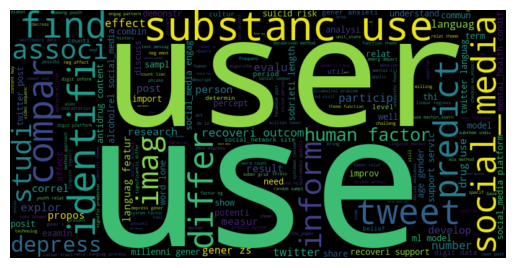

Top authors in community 0: https://openalex.org/A5010646067, https://openalex.org/A5010646067, https://openalex.org/A5010646067


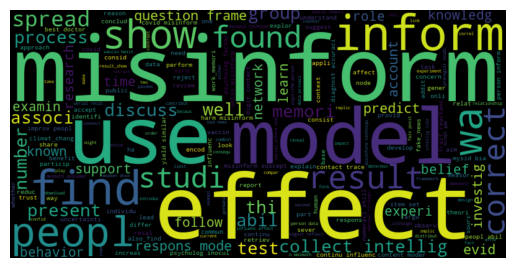

Top authors in community 1: https://openalex.org/A5017914184, https://openalex.org/A5017914184, https://openalex.org/A5017914184


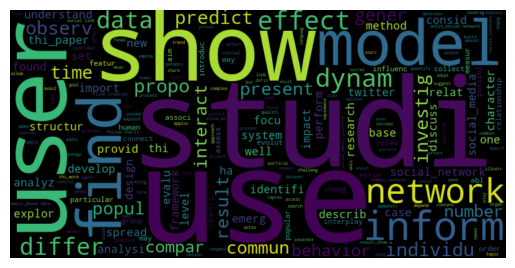

Top authors in community 2: https://openalex.org/A5021346979, https://openalex.org/A5021346979, https://openalex.org/A5021346979


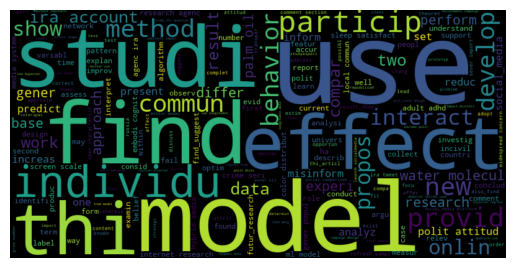

Top authors in community 3: https://openalex.org/A5040468715, https://openalex.org/A5040468715, https://openalex.org/A5040468715


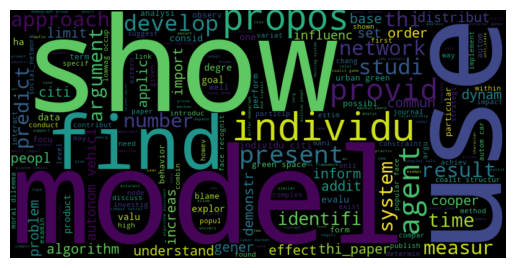

Top authors in community 4: https://openalex.org/A5009232244, https://openalex.org/A5009232244, https://openalex.org/A5009232244


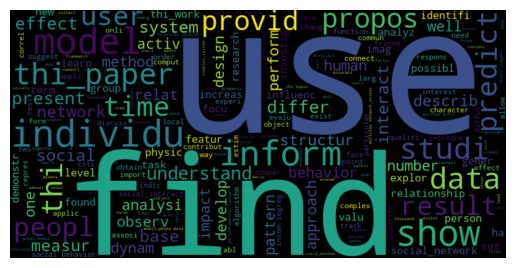

Top authors in community 5: https://openalex.org/A5007176508, https://openalex.org/A5007176508, https://openalex.org/A5007176508


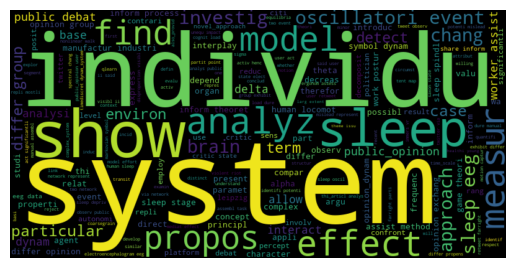

Top authors in community 6: https://openalex.org/A5074755166, https://openalex.org/A5074755166, https://openalex.org/A5074755166


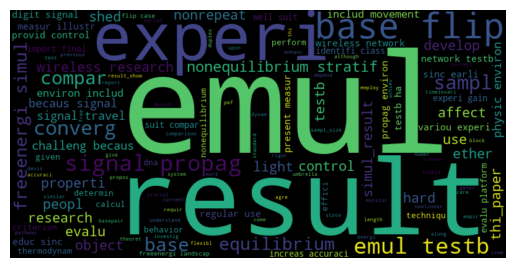

Top authors in community 7: https://openalex.org/A5030909944, https://openalex.org/A5030909944, https://openalex.org/A5027868275


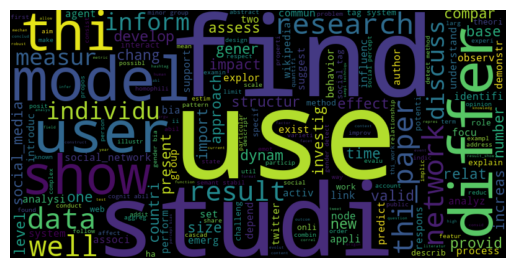

Top authors in community 8: https://openalex.org/A5071422618, https://openalex.org/A5071422618, https://openalex.org/A5071422618


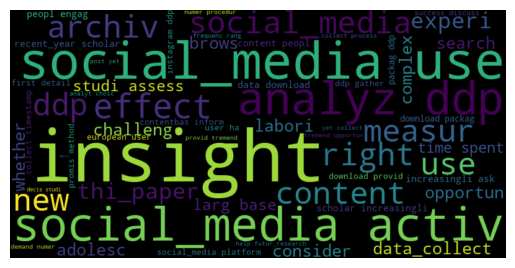

Top authors in community 9: https://openalex.org/A5026212091, https://openalex.org/A5072912426, https://openalex.org/A5029647082


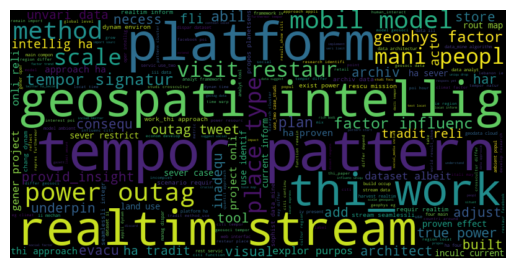

Top authors in community 10: https://openalex.org/A5001338204, https://openalex.org/A5001338204, https://openalex.org/A5001338204


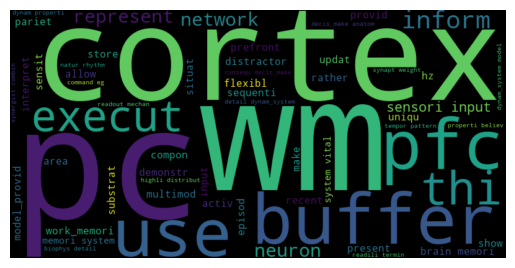

Top authors in community 11: https://openalex.org/A5010352723, https://openalex.org/A5022994404, https://openalex.org/A5077516931


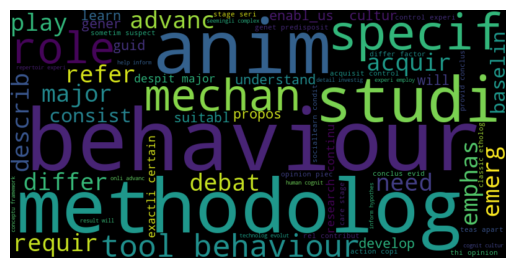

Top authors in community 12: https://openalex.org/A5017717665, https://openalex.org/A5032323046, https://openalex.org/A5086339706


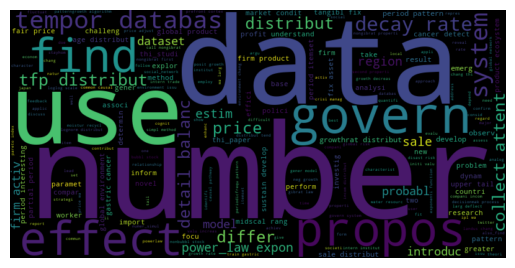

Top authors in community 13: https://openalex.org/A5056438865, https://openalex.org/A5056438865, https://openalex.org/A5056438865


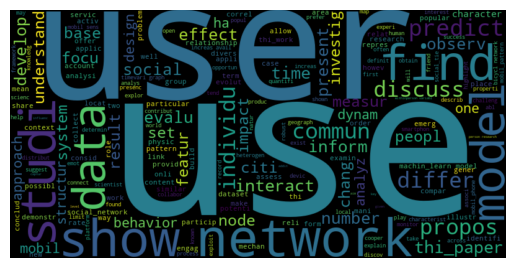

Top authors in community 14: https://openalex.org/A5078886343, https://openalex.org/A5078886343, https://openalex.org/A5078886343


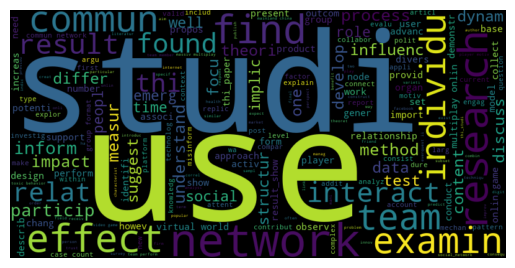

Top authors in community 15: https://openalex.org/A5075283583, https://openalex.org/A5075283583, https://openalex.org/A5075283583


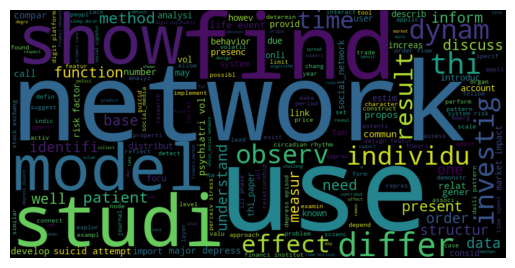

Top authors in community 16: https://openalex.org/A5044033087, https://openalex.org/A5044033087, https://openalex.org/A5044033087


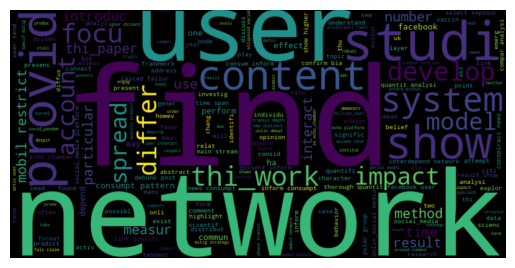

Top authors in community 17: https://openalex.org/A5008291667, https://openalex.org/A5008291667, https://openalex.org/A5008291667


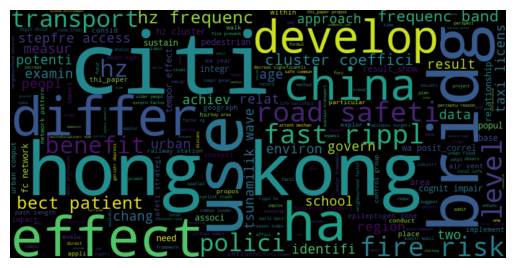

Top authors in community 18: https://openalex.org/A5066649557, https://openalex.org/A5066649557, https://openalex.org/A5066649557


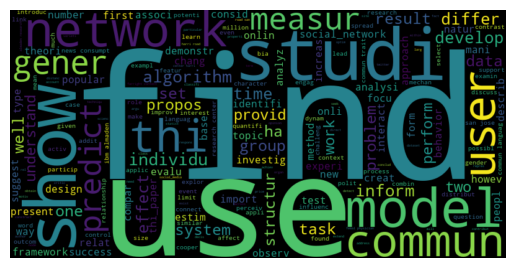

Top authors in community 19: https://openalex.org/A5087088138, https://openalex.org/A5087088138, https://openalex.org/A5087088138


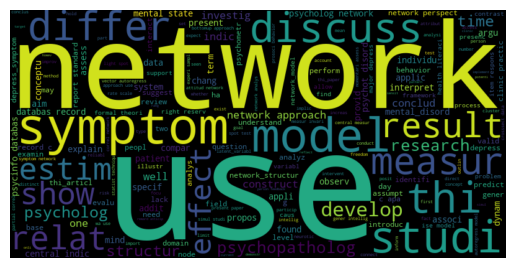

Top authors in community 20: https://openalex.org/A5029100305, https://openalex.org/A5029100305, https://openalex.org/A5029100305


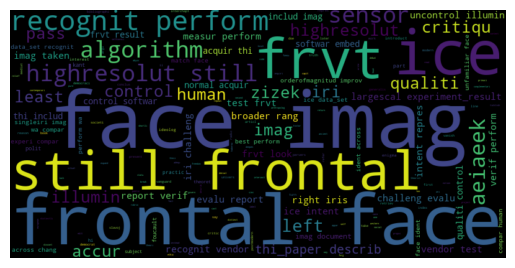

Top authors in community 21: https://openalex.org/A5018181018, https://openalex.org/A5018181018, https://openalex.org/A5018181018


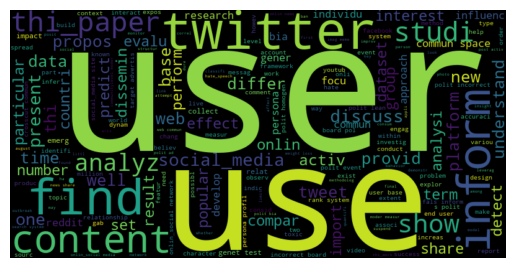

Top authors in community 22: https://openalex.org/A5061923992, https://openalex.org/A5061923992, https://openalex.org/A5061923992


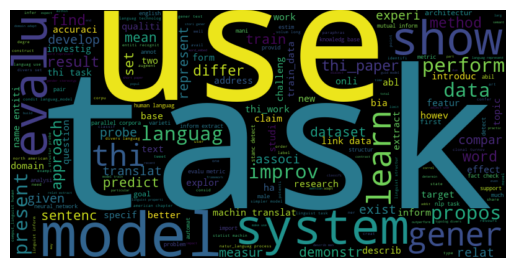

Top authors in community 23: https://openalex.org/A5061951606, https://openalex.org/A5061951606, https://openalex.org/A5061951606


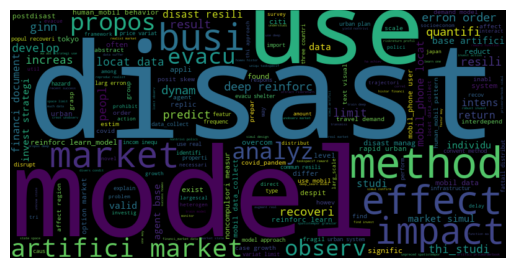

Top authors in community 24: https://openalex.org/A5044205949, https://openalex.org/A5044205949, https://openalex.org/A5044205949


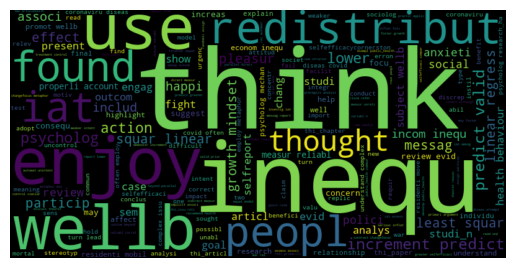

Top authors in community 25: https://openalex.org/A5047385425, https://openalex.org/A5047385425, https://openalex.org/A5047385425


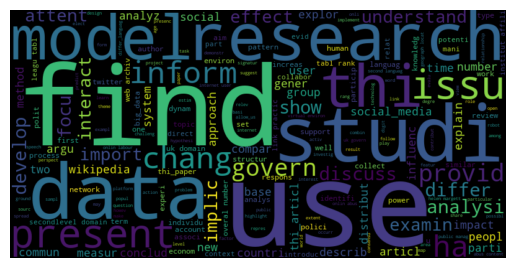

Top authors in community 26: https://openalex.org/A5067625837, https://openalex.org/A5067625837, https://openalex.org/A5067625837


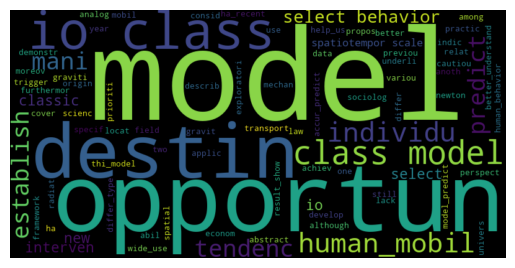

Top authors in community 27: https://openalex.org/A5077515904, https://openalex.org/A5062610763


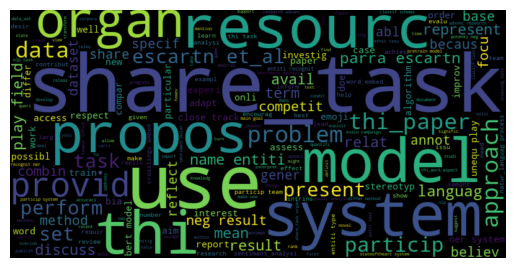

Top authors in community 28: https://openalex.org/A5017409996, https://openalex.org/A5017409996, https://openalex.org/A5017409996


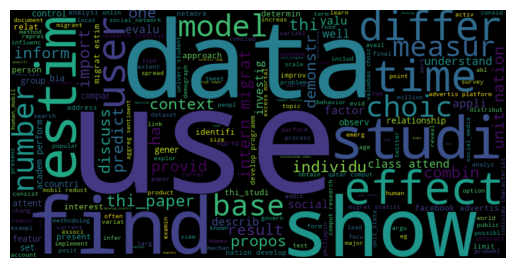

Top authors in community 29: https://openalex.org/A5033656008, https://openalex.org/A5033656008, https://openalex.org/A5033656008


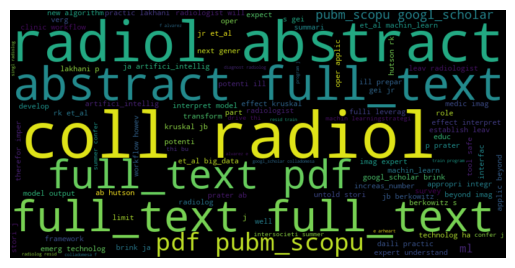

Top authors in community 30: https://openalex.org/A5047611362, https://openalex.org/A5054432618, https://openalex.org/A5005696882


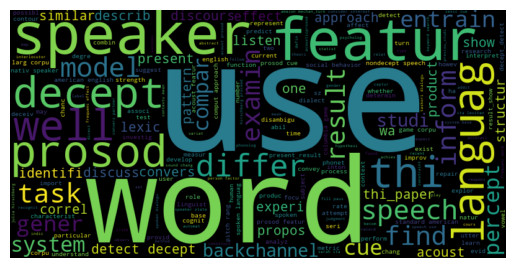

Top authors in community 31: https://openalex.org/A5045037642, https://openalex.org/A5045037642, https://openalex.org/A5045037642


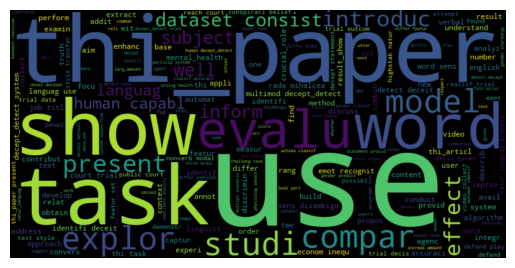

Top authors in community 32: https://openalex.org/A5082450455, https://openalex.org/A5082450455, https://openalex.org/A5082450455


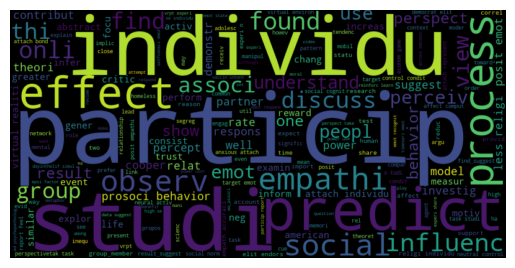

Top authors in community 33: https://openalex.org/A5047315859, https://openalex.org/A5047315859, https://openalex.org/A5047315859


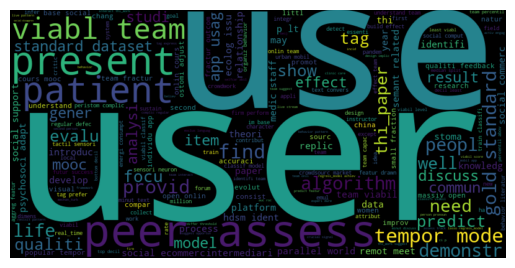

Top authors in community 34: https://openalex.org/A5088335237, https://openalex.org/A5088335237, https://openalex.org/A5088335237


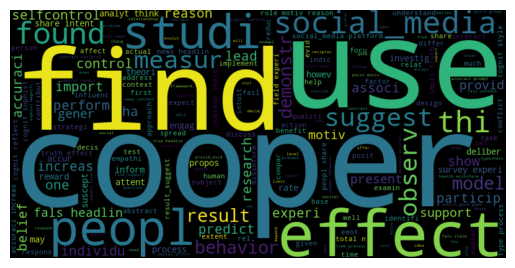

Top authors in community 35: https://openalex.org/A5056499434, https://openalex.org/A5056499434, https://openalex.org/A5056499434


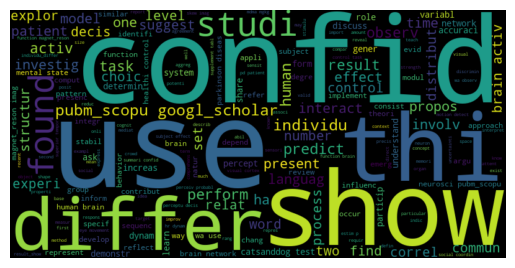

Top authors in community 36: https://openalex.org/A5005493160, https://openalex.org/A5005493160, https://openalex.org/A5005493160


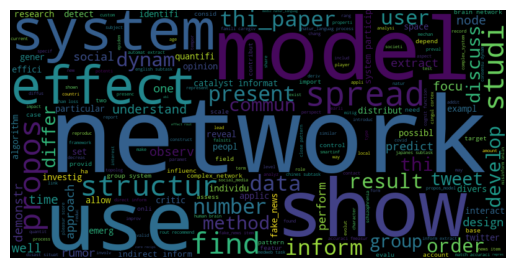

Top authors in community 37: https://openalex.org/A5034372799, https://openalex.org/A5034372799, https://openalex.org/A5034372799


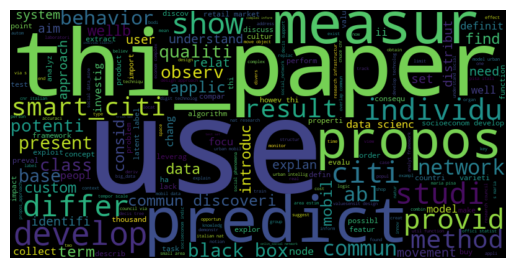

Top authors in community 38: https://openalex.org/A5024505700, https://openalex.org/A5024505700, https://openalex.org/A5024505700


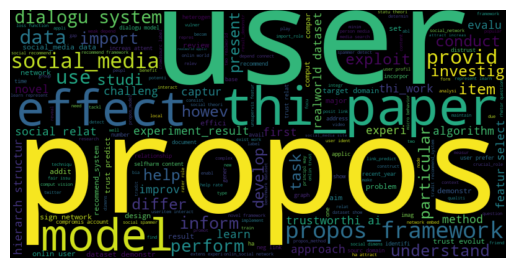

Top authors in community 39: https://openalex.org/A5040639891, https://openalex.org/A5040639891, https://openalex.org/A5040639891


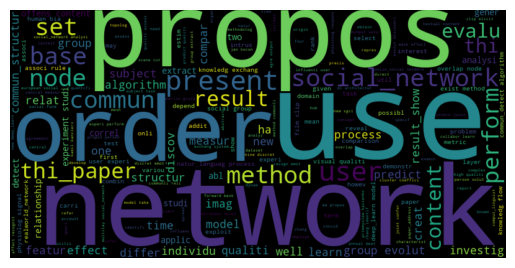

Top authors in community 40: https://openalex.org/A5049612210, https://openalex.org/A5049612210, https://openalex.org/A5049612210


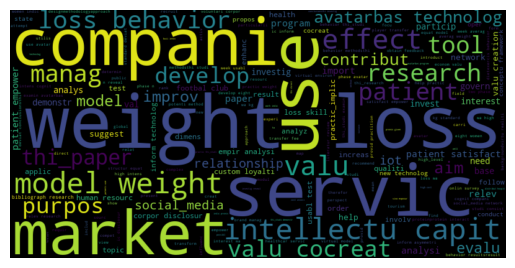

Top authors in community 41: https://openalex.org/A5052040863, https://openalex.org/A5052040863, https://openalex.org/A5052040863


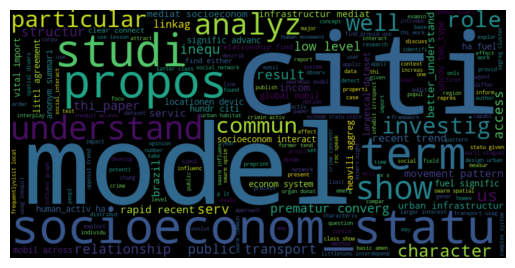

Top authors in community 42: https://openalex.org/A5033081182, https://openalex.org/A5033081182, https://openalex.org/A5033081182


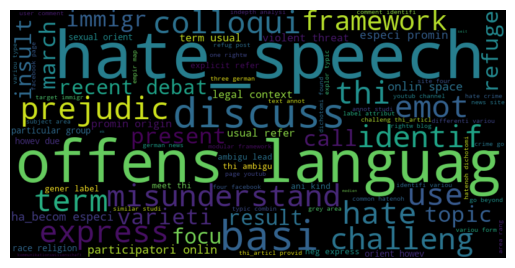

Top authors in community 43: https://openalex.org/A5054191107, https://openalex.org/A5012631395, https://openalex.org/A5012631395


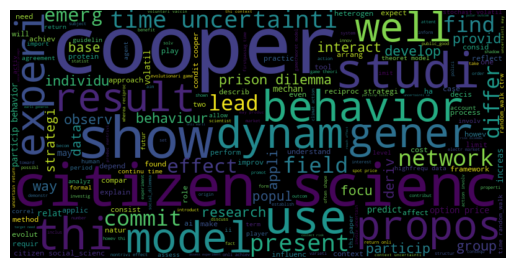

Top authors in community 44: https://openalex.org/A5093039163, https://openalex.org/A5093039163, https://openalex.org/A5093039163


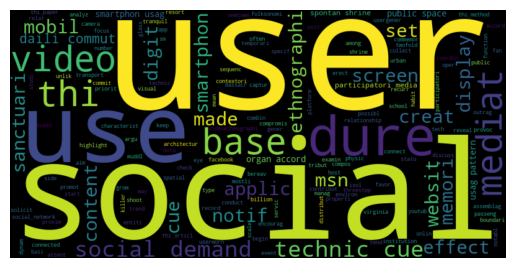

Top authors in community 45: https://openalex.org/A5016401839, https://openalex.org/A5016401839, https://openalex.org/A5024176058


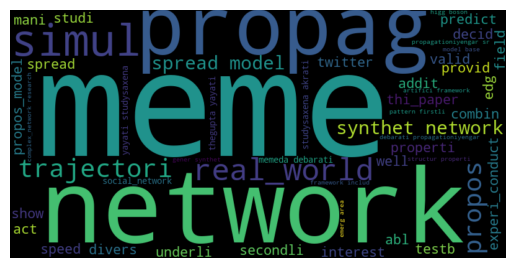

Top authors in community 46: https://openalex.org/A5062149129, https://openalex.org/A5055236010, https://openalex.org/A5004420568


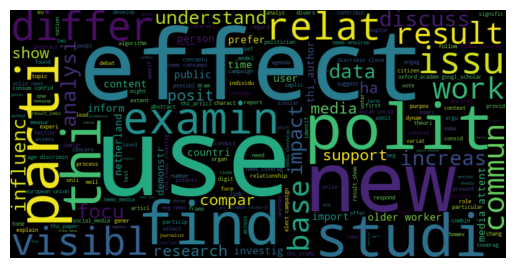

Top authors in community 47: https://openalex.org/A5077381667, https://openalex.org/A5077381667, https://openalex.org/A5077381667


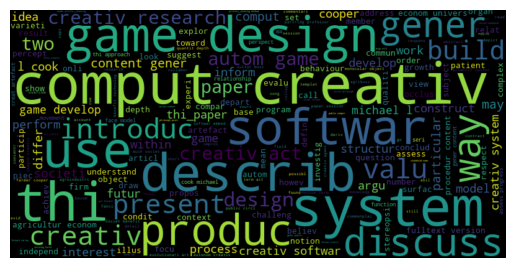

Top authors in community 48: https://openalex.org/A5084471568, https://openalex.org/A5084471568, https://openalex.org/A5084471568


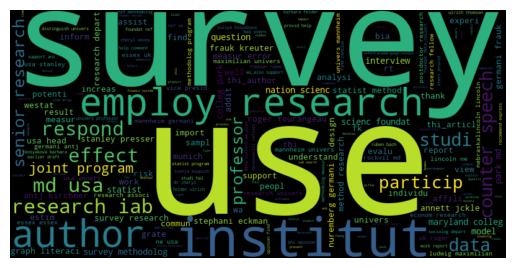

Top authors in community 49: https://openalex.org/A5038390320, https://openalex.org/A5038390320, https://openalex.org/A5038390320


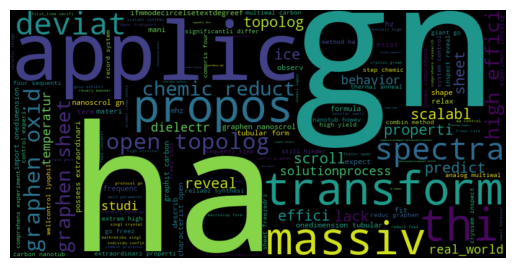

Top authors in community 50: https://openalex.org/A5007994819, https://openalex.org/A5007994819, https://openalex.org/A5042300381


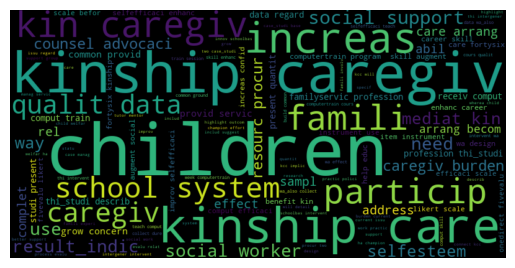

Top authors in community 51: https://openalex.org/A5006307162, https://openalex.org/A5006307162, https://openalex.org/A5015211752


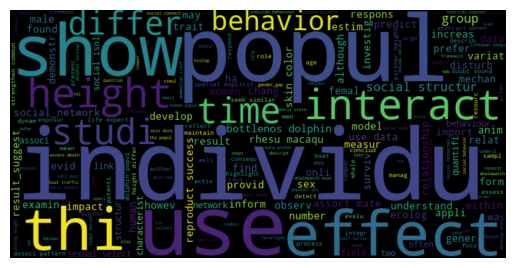

Top authors in community 52: https://openalex.org/A5017444948, https://openalex.org/A5017444948, https://openalex.org/A5017444948


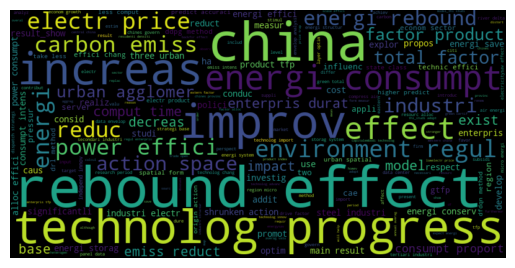

Top authors in community 53: https://openalex.org/A5080163144, https://openalex.org/A5080163144, https://openalex.org/A5080163144


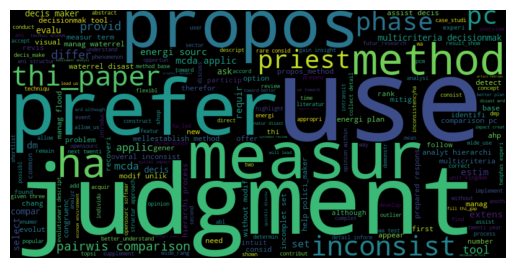

Top authors in community 54: https://openalex.org/A5024786684, https://openalex.org/A5024786684, https://openalex.org/A5024786684


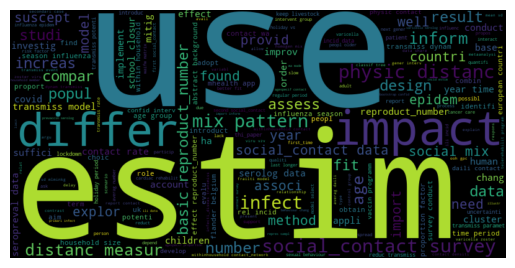

Top authors in community 55: https://openalex.org/A5042663607, https://openalex.org/A5042663607, https://openalex.org/A5042663607


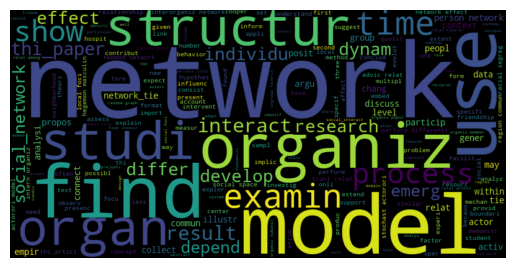

Top authors in community 56: https://openalex.org/A5018108132, https://openalex.org/A5018108132, https://openalex.org/A5018108132


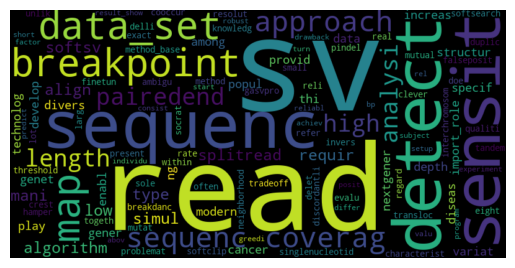

Top authors in community 57: https://openalex.org/A5062364819, https://openalex.org/A5002071945


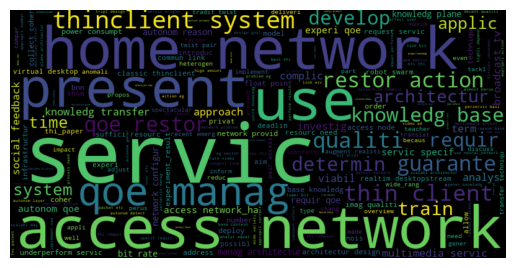

Top authors in community 58: https://openalex.org/A5001314520, https://openalex.org/A5001314520, https://openalex.org/A5001314520


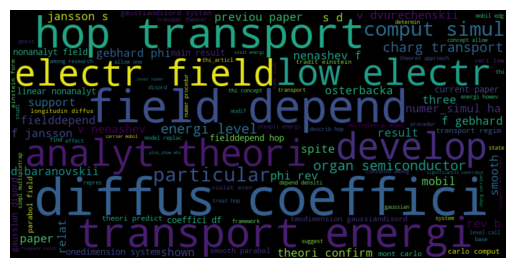

Top authors in community 59: https://openalex.org/A5022455238, https://openalex.org/A5022455238, https://openalex.org/A5090042292


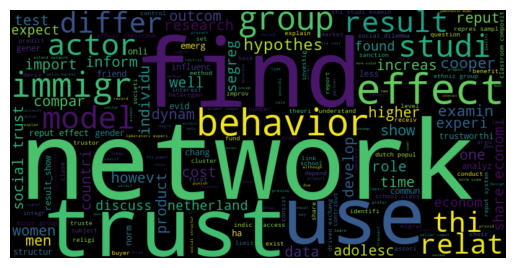

Top authors in community 61: https://openalex.org/A5064626129, https://openalex.org/A5064626129, https://openalex.org/A5064626129


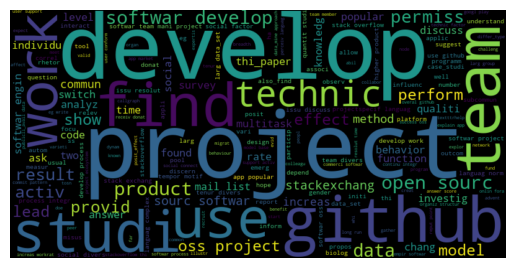

Top authors in community 62: https://openalex.org/A5040217228, https://openalex.org/A5040217228, https://openalex.org/A5040217228


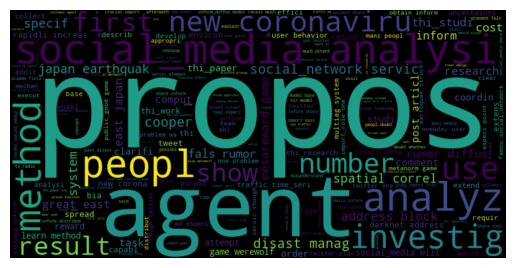

Top authors in community 63: https://openalex.org/A5011275718, https://openalex.org/A5045655458


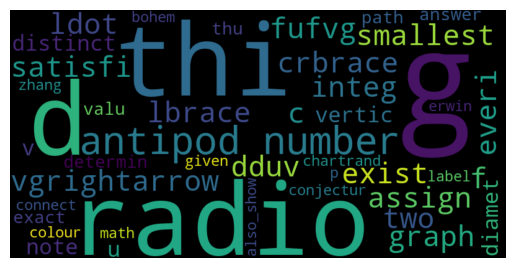

Top authors in community 64: https://openalex.org/A5058810080


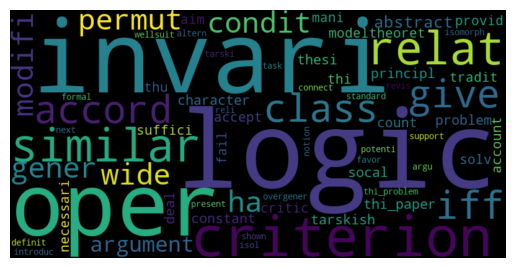

Top authors in community 65: https://openalex.org/A5083716771, https://openalex.org/A5083716771, https://openalex.org/A5083716771


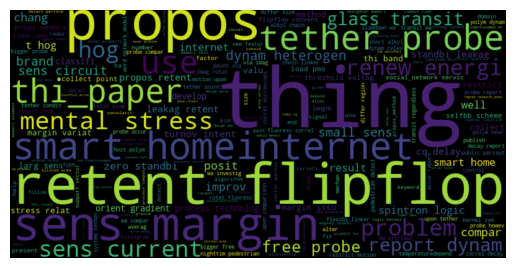

Top authors in community 66: https://openalex.org/A5009316832, https://openalex.org/A5009316832, https://openalex.org/A5009316832


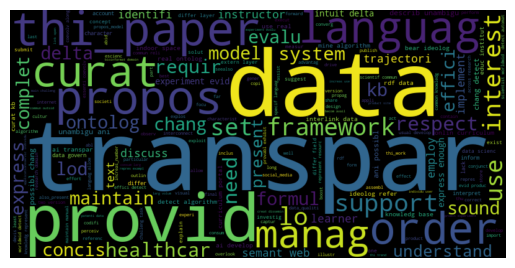

Top authors in community 67: https://openalex.org/A5037204027, https://openalex.org/A5044778419, https://openalex.org/A5073153681


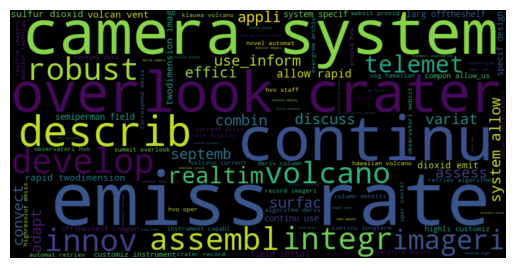

Top authors in community 69: https://openalex.org/A5037220308, https://openalex.org/A5037220308, https://openalex.org/A5004381930


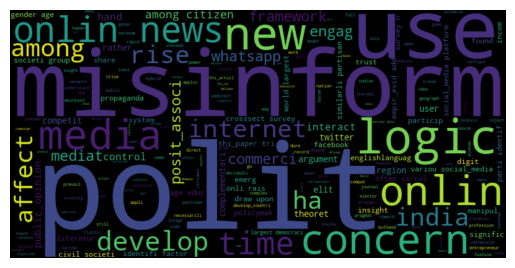

Top authors in community 70: https://openalex.org/A5069608785, https://openalex.org/A5069608785, https://openalex.org/A5069608785


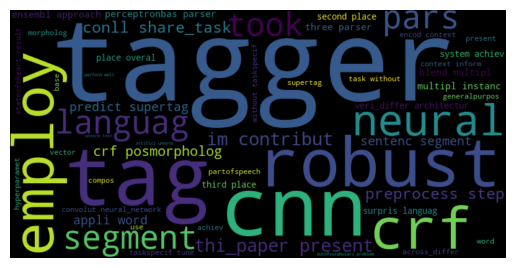

Top authors in community 71: https://openalex.org/A5073502448, https://openalex.org/A5073502448, https://openalex.org/A5073502448


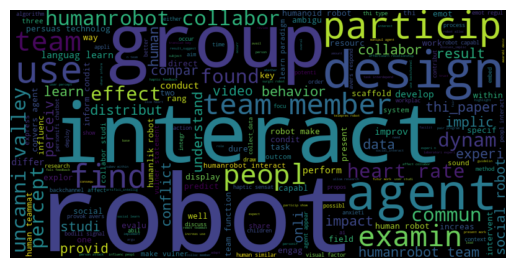

Top authors in community 72: https://openalex.org/A5034410008, https://openalex.org/A5034410008, https://openalex.org/A5050855225


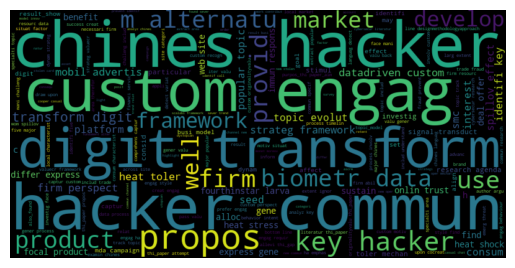

Top authors in community 73: https://openalex.org/A5025144355, https://openalex.org/A5025144355, https://openalex.org/A5025144355


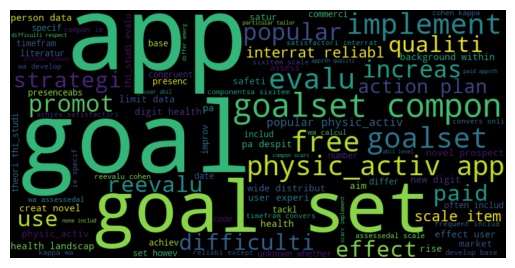

Top authors in community 74: https://openalex.org/A5079313615, https://openalex.org/A5033244104


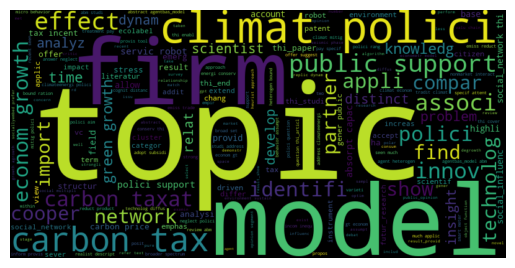

Top authors in community 75: https://openalex.org/A5044956842, https://openalex.org/A5044956842, https://openalex.org/A5065998818


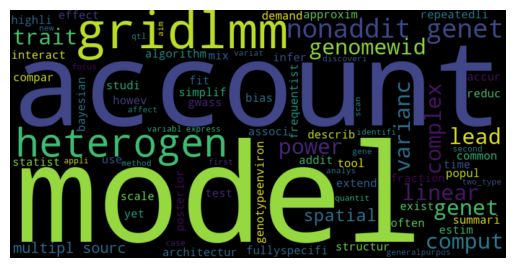

Top authors in community 76: https://openalex.org/A5053957245, https://openalex.org/A5053957245, https://openalex.org/A5053957245


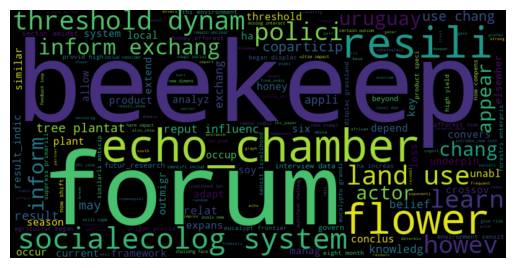

Top authors in community 77: https://openalex.org/A5059840085, https://openalex.org/A5059840085, https://openalex.org/A5059840085


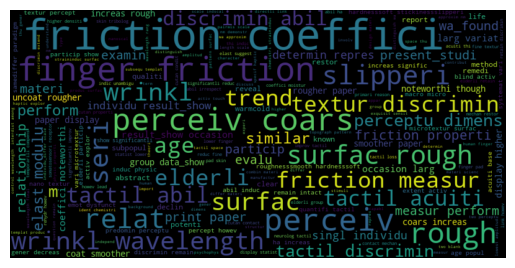

Top authors in community 79: https://openalex.org/A5061502731, https://openalex.org/A5061502731, https://openalex.org/A5061502731


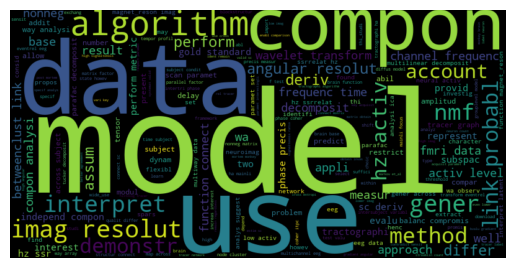

Top authors in community 80: https://openalex.org/A5091787895, https://openalex.org/A5091787895, https://openalex.org/A5091787895


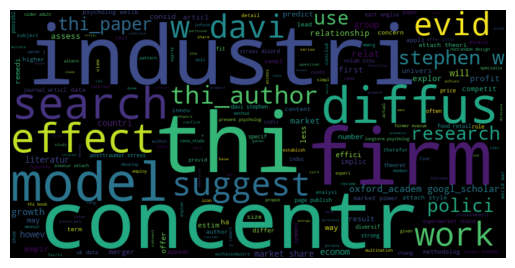

Top authors in community 81: https://openalex.org/A5075080019, https://openalex.org/A5075080019, https://openalex.org/A5075080019


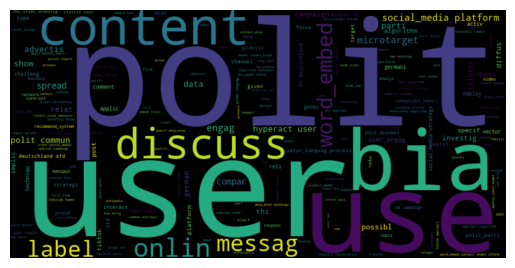

Top authors in community 82: https://openalex.org/A5081165962, https://openalex.org/A5081165962, https://openalex.org/A5081165962


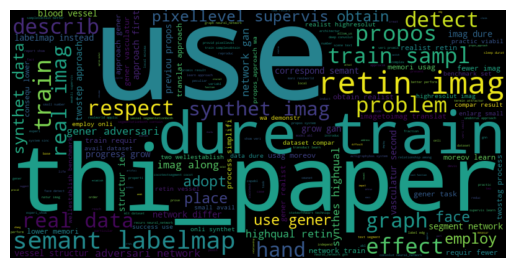

Top authors in community 83: https://openalex.org/A5083969011, https://openalex.org/A5083969011, https://openalex.org/A5015599068


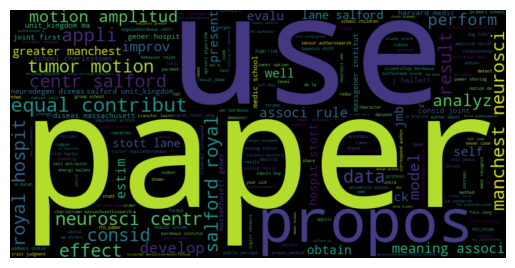

Top authors in community 84: https://openalex.org/A5073838075, https://openalex.org/A5073838075, https://openalex.org/A5073838075


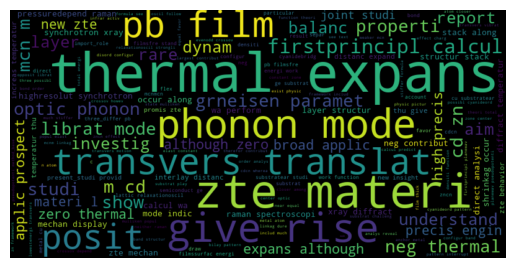

Top authors in community 85: https://openalex.org/A5066138111, https://openalex.org/A5066138111, https://openalex.org/A5066138111


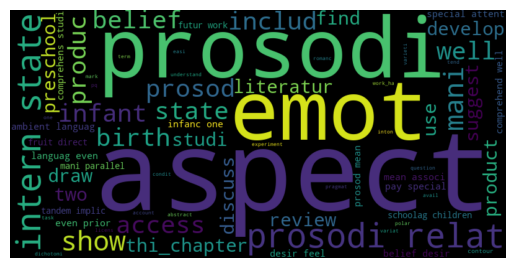

Top authors in community 86: https://openalex.org/A5037841475, https://openalex.org/A5089637526


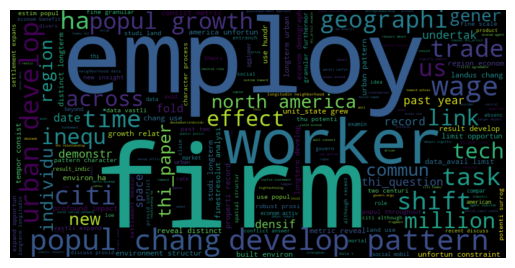

Top authors in community 87: https://openalex.org/A5061152084, https://openalex.org/A5081436094, https://openalex.org/A5026853863


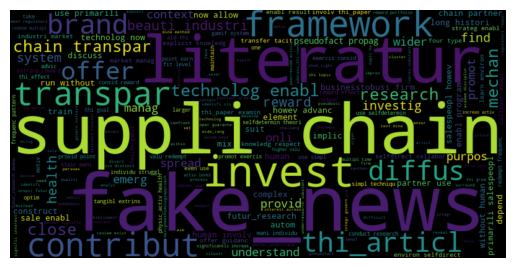

Top authors in community 88: https://openalex.org/A5029845004, https://openalex.org/A5027137927, https://openalex.org/A5059668842


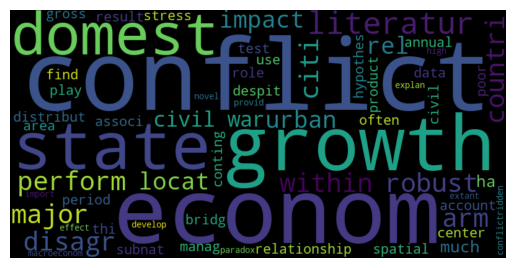

Top authors in community 89: https://openalex.org/A5025141355, https://openalex.org/A5025141355, https://openalex.org/A5025141355


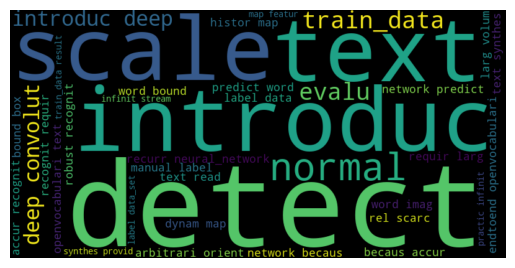

Top authors in community 90: https://openalex.org/A5062844781, https://openalex.org/A5062844781, https://openalex.org/A5062844781


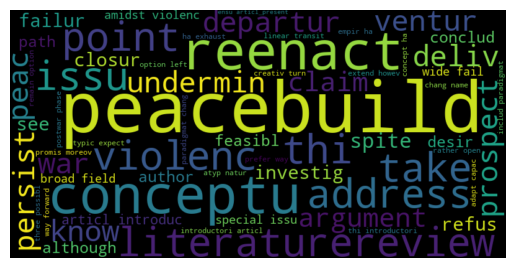

Top authors in community 91: https://openalex.org/A5053954934, https://openalex.org/A5005813769, https://openalex.org/A5067028141


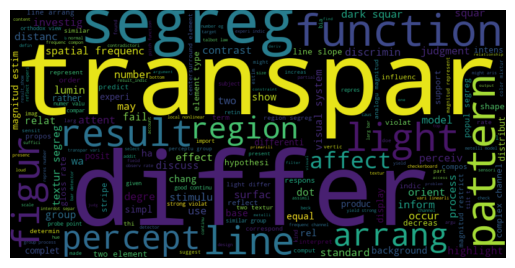

Top authors in community 92: https://openalex.org/A5060277811, https://openalex.org/A5060277811, https://openalex.org/A5060277811


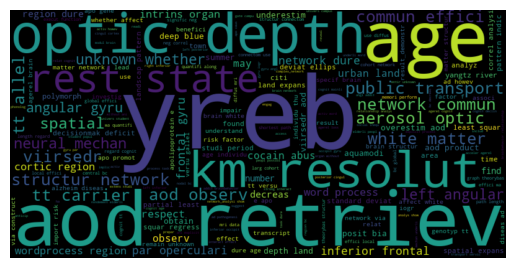

Top authors in community 93: https://openalex.org/A5029483412, https://openalex.org/A5029483412, https://openalex.org/A5029483412


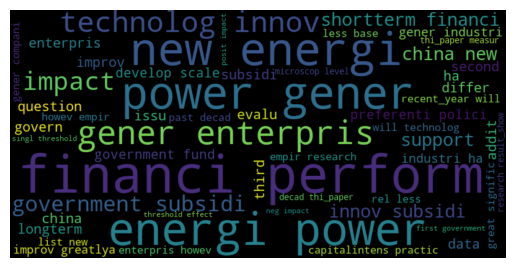

Top authors in community 94: https://openalex.org/A5065544460, https://openalex.org/A5065544460, https://openalex.org/A5065544460


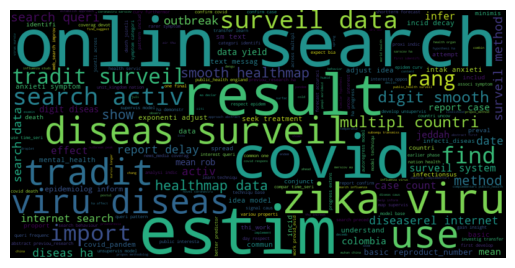

Top authors in community 95: https://openalex.org/A5078789709, https://openalex.org/A5023667387, https://openalex.org/A5042122864


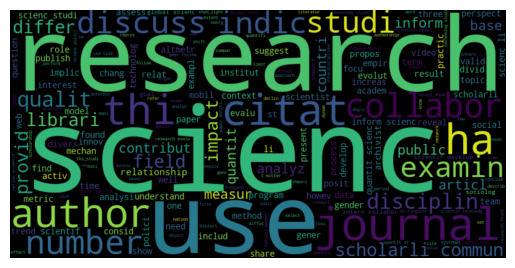

Top authors in community 96: https://openalex.org/A5010691256, https://openalex.org/A5010691256, https://openalex.org/A5010691256


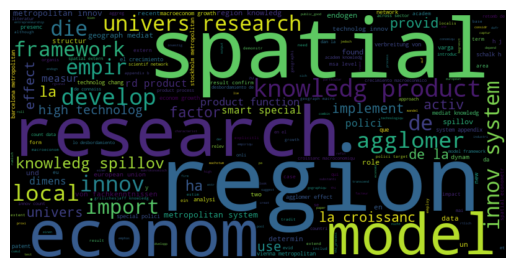

Top authors in community 97: https://openalex.org/A5048997213, https://openalex.org/A5048997213, https://openalex.org/A5034550396


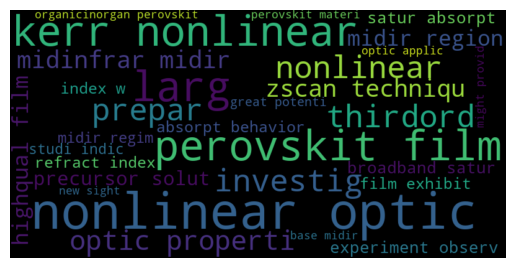

Top authors in community 98: https://openalex.org/A5022552949, https://openalex.org/A5022552949, https://openalex.org/A5035665050


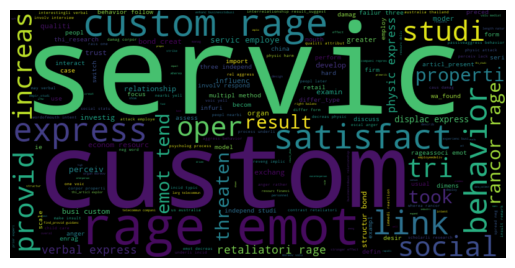

Top authors in community 99: https://openalex.org/A5001227032, https://openalex.org/A5001227032, https://openalex.org/A5001227032


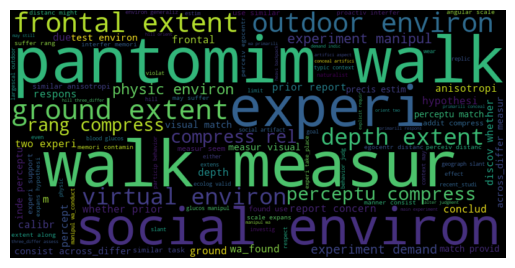

Top authors in community 100: https://openalex.org/A5042644425, https://openalex.org/A5083816730


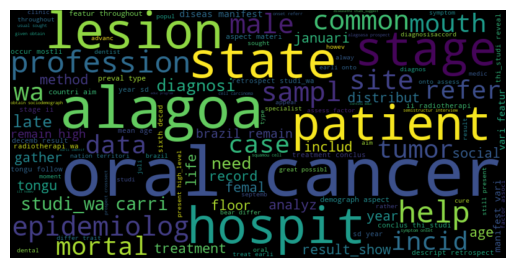

Top authors in community 101: https://openalex.org/A5060256587, https://openalex.org/A5060256587, https://openalex.org/A5015346324


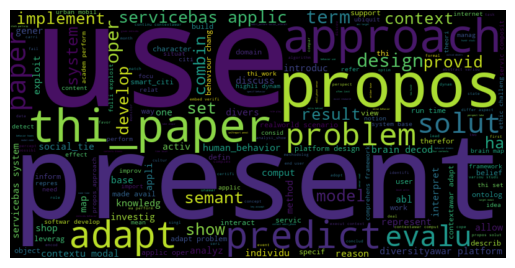

Top authors in community 102: https://openalex.org/A5038304782, https://openalex.org/A5038217519


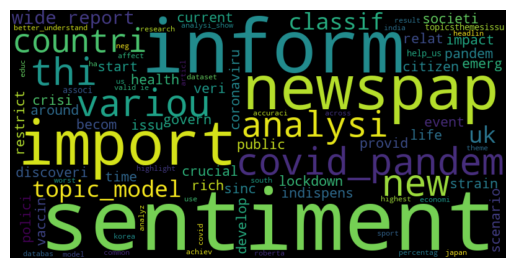

Top authors in community 103: https://openalex.org/A5030406488, https://openalex.org/A5030406488, https://openalex.org/A5063237850


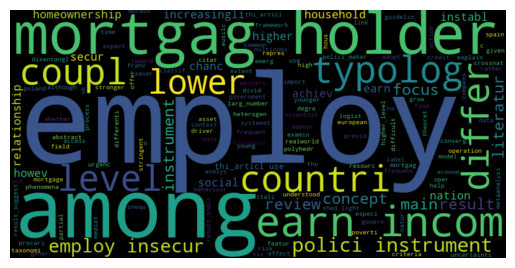

Top authors in community 104: https://openalex.org/A5066420511, https://openalex.org/A5066420511, https://openalex.org/A5066420511


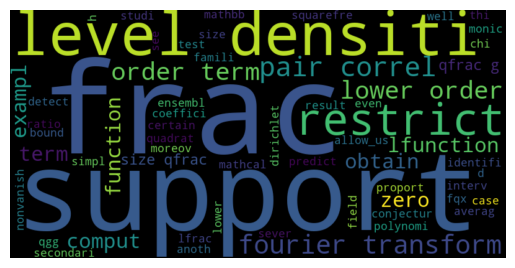

Top authors in community 105: https://openalex.org/A5009325217, https://openalex.org/A5009325217, https://openalex.org/A5009325217


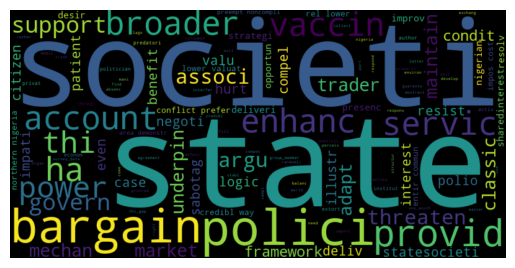

Top authors in community 106: https://openalex.org/A5050252738, https://openalex.org/A5050252738, https://openalex.org/A5021509895


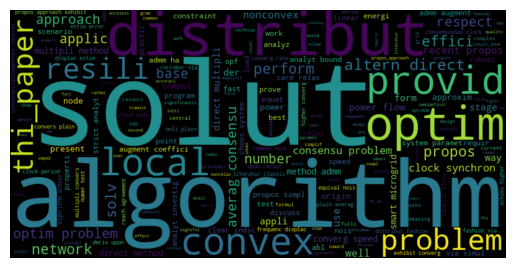

Top authors in community 107: https://openalex.org/A5012678897, https://openalex.org/A5004870383, https://openalex.org/A5022448878


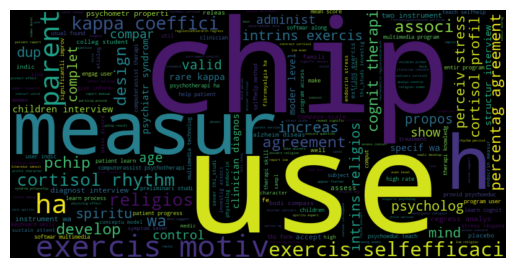

Top authors in community 108: https://openalex.org/A5035021472, https://openalex.org/A5035021472, https://openalex.org/A5035021472


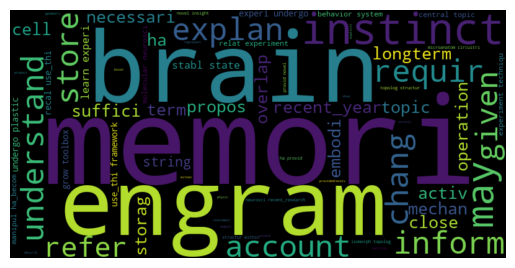

Top authors in community 110: https://openalex.org/A5071988241, https://openalex.org/A5071988241, https://openalex.org/A5071988241


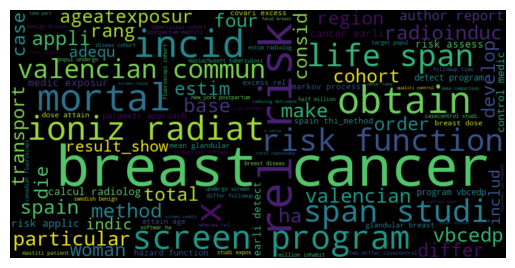

Top authors in community 111: https://openalex.org/A5046618110, https://openalex.org/A5046618110, https://openalex.org/A5046618110


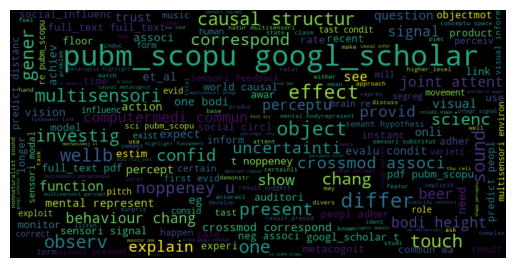

Top authors in community 112: https://openalex.org/A5011446833, https://openalex.org/A5022195747, https://openalex.org/A5010639399


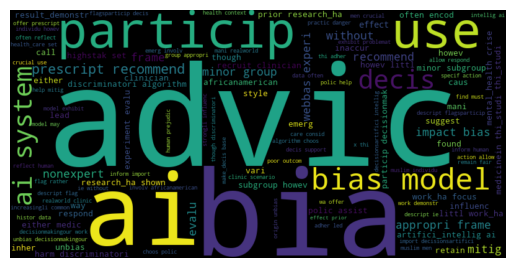

Top authors in community 113: https://openalex.org/A5053681451, https://openalex.org/A5037260207, https://openalex.org/A5025559460


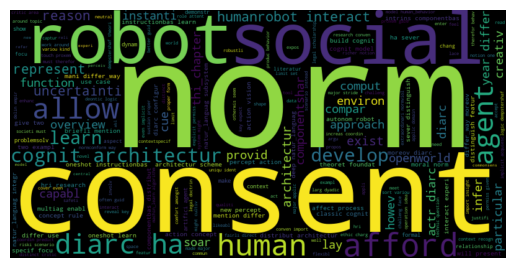

Top authors in community 114: https://openalex.org/A5085814944, https://openalex.org/A5045789277, https://openalex.org/A5063840122


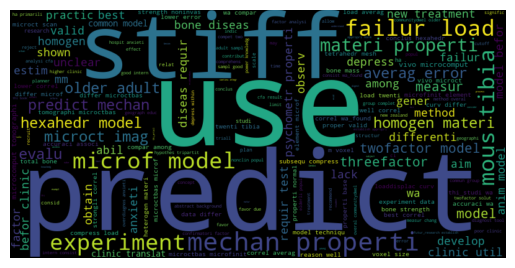

Top authors in community 115: https://openalex.org/A5086981709, https://openalex.org/A5086243139


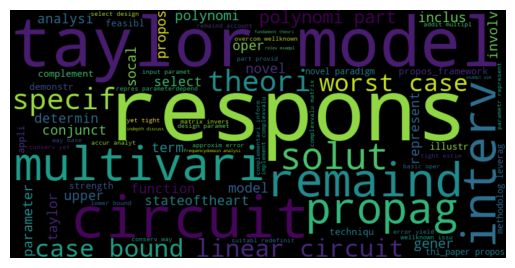

Top authors in community 116: https://openalex.org/A5072498572, https://openalex.org/A5072498572, https://openalex.org/A5072498572


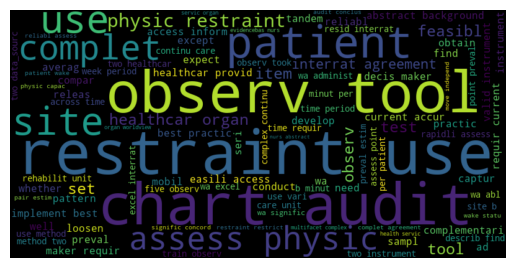

Top authors in community 117: https://openalex.org/A5080376515, https://openalex.org/A5080376515, https://openalex.org/A5080376515


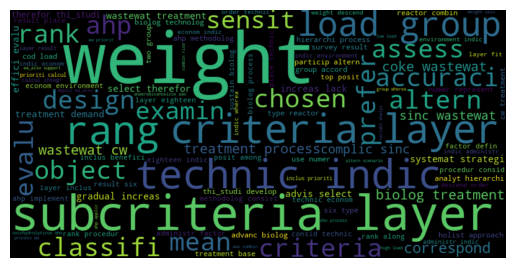

Top authors in community 118: https://openalex.org/A5074241509, https://openalex.org/A5069995009, https://openalex.org/A5089329957


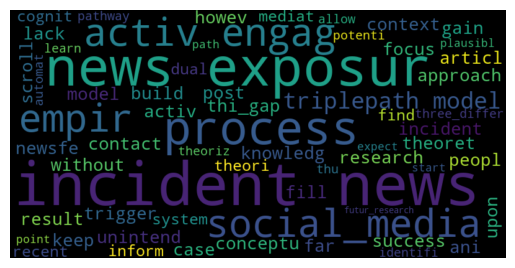

Top authors in community 119: https://openalex.org/A5074137374, https://openalex.org/A5074137374, https://openalex.org/A5074137374


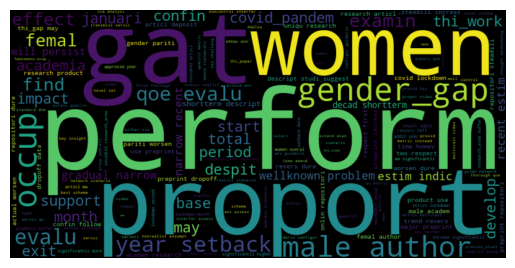

Top authors in community 120: https://openalex.org/A5034405667, https://openalex.org/A5034405667, https://openalex.org/A5034405667


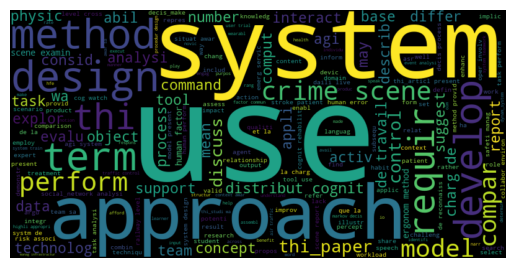

Top authors in community 121: https://openalex.org/A5069533167, https://openalex.org/A5085932729


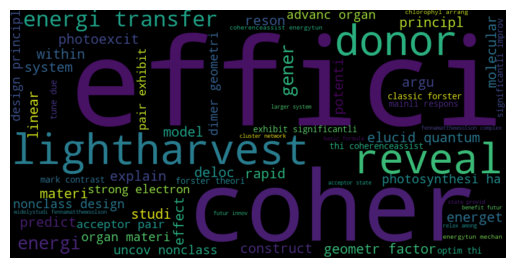

Top authors in community 122: https://openalex.org/A5003134531, https://openalex.org/A5031740597, https://openalex.org/A5051656423


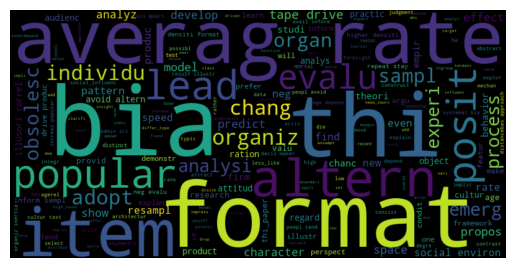

Top authors in community 123: https://openalex.org/A5014435955, https://openalex.org/A5082861306


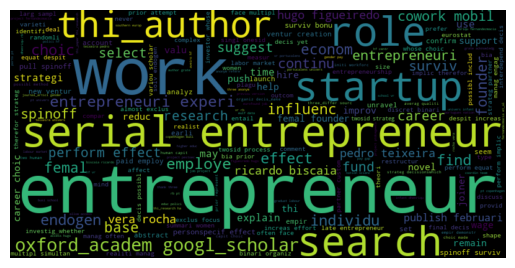

Top authors in community 124: https://openalex.org/A5054478253, https://openalex.org/A5054478253, https://openalex.org/A5054478253


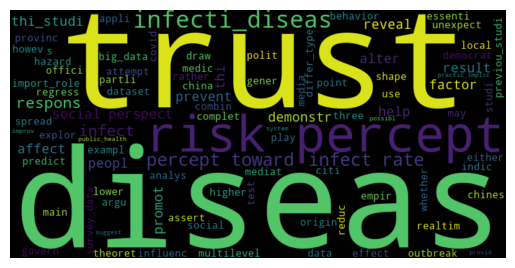

Top authors in community 125: https://openalex.org/A5064290037, https://openalex.org/A5064290037, https://openalex.org/A5064290037


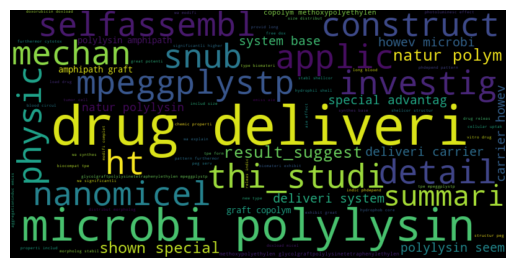

Top authors in community 126: https://openalex.org/A5027363618, https://openalex.org/A5029246651, https://openalex.org/A5051597957


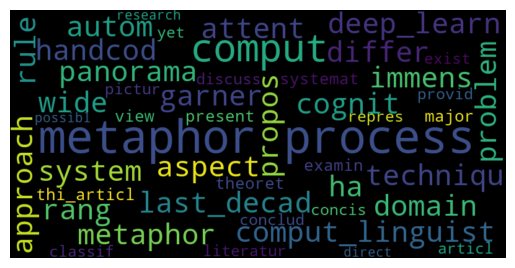

Top authors in community 127: https://openalex.org/A5070892042, https://openalex.org/A5028120689, https://openalex.org/A5034204065


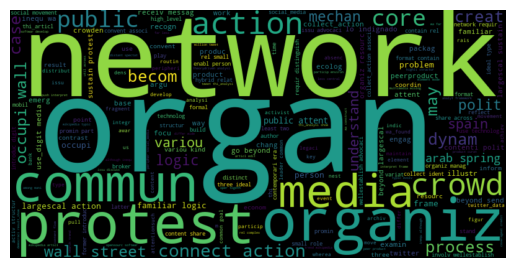

Top authors in community 128: https://openalex.org/A5021838428, https://openalex.org/A5006712471, https://openalex.org/A5002323911


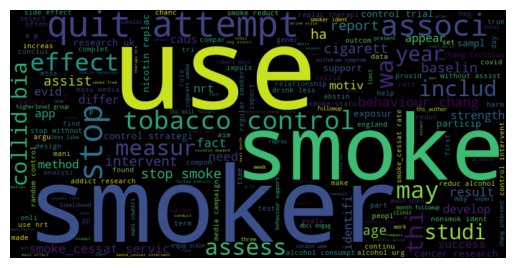

Top authors in community 129: https://openalex.org/A5087607093, https://openalex.org/A5087607093, https://openalex.org/A5000566142


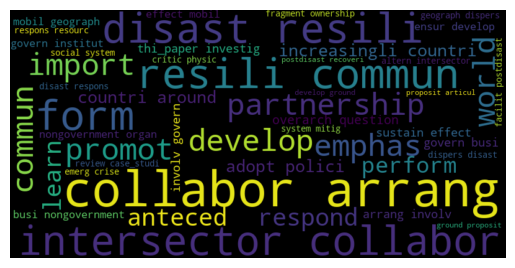

Top authors in community 130: https://openalex.org/A5037234320, https://openalex.org/A5037234320, https://openalex.org/A5037234320


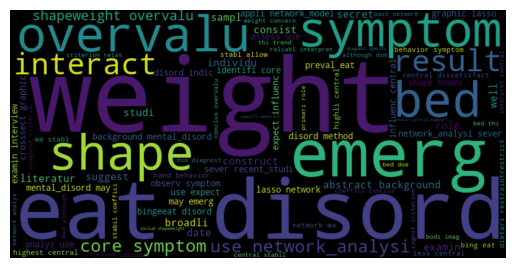

Top authors in community 131: https://openalex.org/A5050372797, https://openalex.org/A5050372797, https://openalex.org/A5050372797


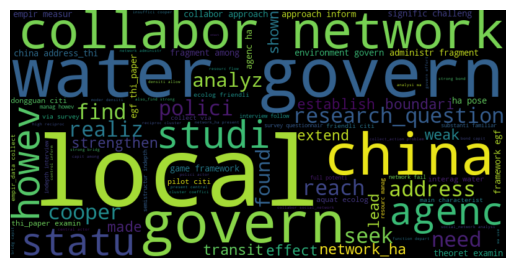

Top authors in community 132: https://openalex.org/A5079636968, https://openalex.org/A5028631384, https://openalex.org/A5028631384


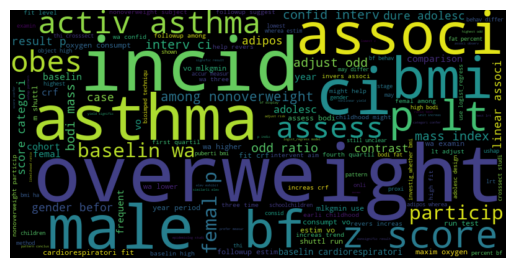

Top authors in community 133: https://openalex.org/A5040523461, https://openalex.org/A5040523461, https://openalex.org/A5040523461


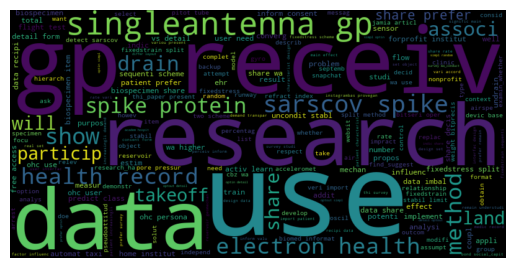

Top authors in community 134: https://openalex.org/A5015311126, https://openalex.org/A5015311126, https://openalex.org/A5015311126


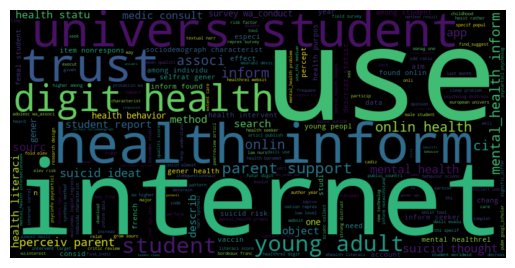

Top authors in community 135: https://openalex.org/A5022601535, https://openalex.org/A5022601535, https://openalex.org/A5022601535


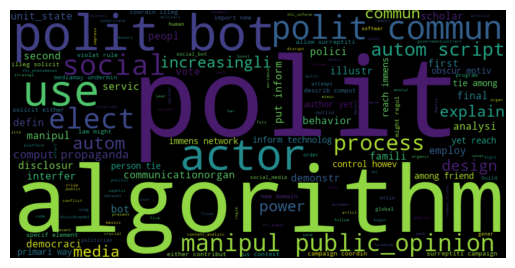

Top authors in community 136: https://openalex.org/A5000043933, https://openalex.org/A5000043933, https://openalex.org/A5000043933


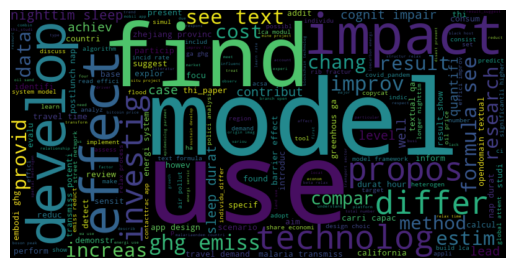

Top authors in community 137: https://openalex.org/A5046276657, https://openalex.org/A5046276657, https://openalex.org/A5046276657


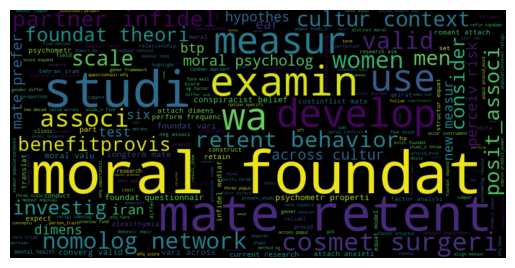

Top authors in community 138: https://openalex.org/A5084537405, https://openalex.org/A5084537405, https://openalex.org/A5084537405


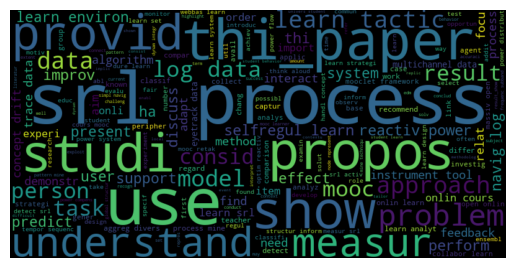

Top authors in community 139: https://openalex.org/A5041505286, https://openalex.org/A5068201653, https://openalex.org/A5005941967


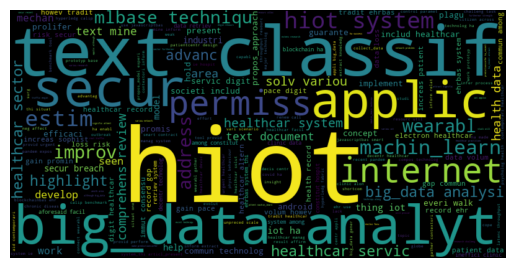

Top authors in community 140: https://openalex.org/A5011126050, https://openalex.org/A5011126050, https://openalex.org/A5011126050


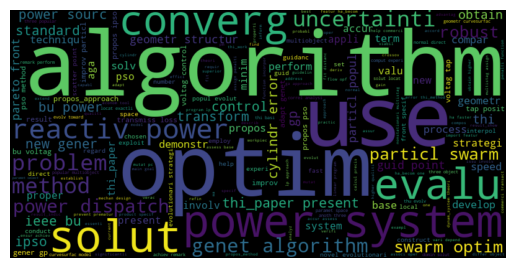

Top authors in community 141: https://openalex.org/A5051428004, https://openalex.org/A5046097382, https://openalex.org/A5070799203


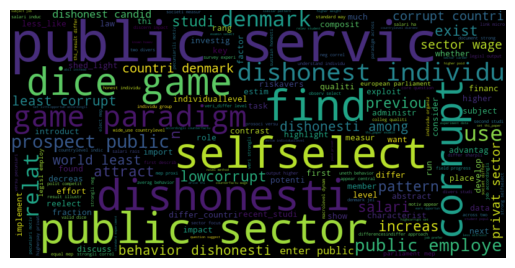

Top authors in community 142: https://openalex.org/A5022647373, https://openalex.org/A5022647373, https://openalex.org/A5022647373


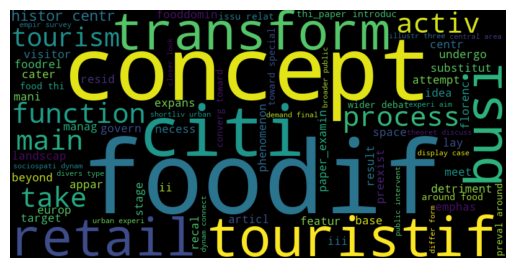

Top authors in community 143: https://openalex.org/A5005540314, https://openalex.org/A5062709079, https://openalex.org/A5053493294


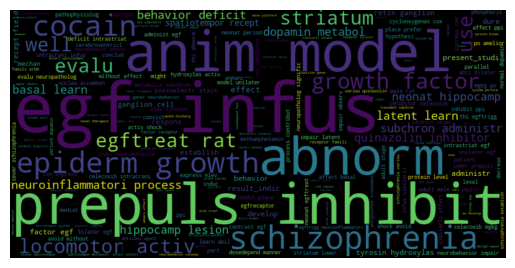

Top authors in community 144: https://openalex.org/A5072883637, https://openalex.org/A5072883637, https://openalex.org/A5007067645


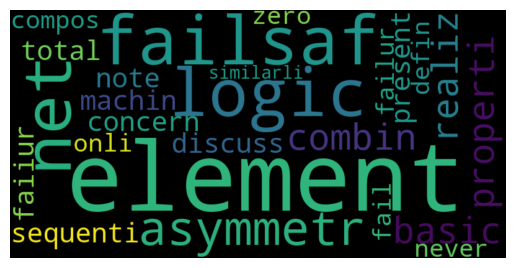

Top authors in community 145: https://openalex.org/A5088397418, https://openalex.org/A5079177338, https://openalex.org/A5079177338


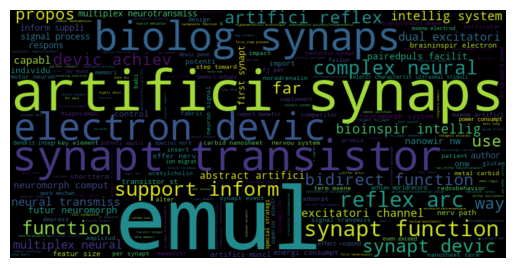

Top authors in community 146: https://openalex.org/A5089186571, https://openalex.org/A5089186571, https://openalex.org/A5089186571


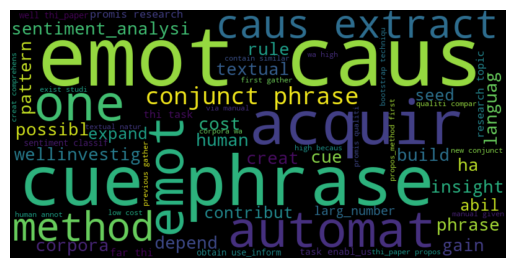

Top authors in community 147: https://openalex.org/A5035471852, https://openalex.org/A5035471852, https://openalex.org/A5066818775


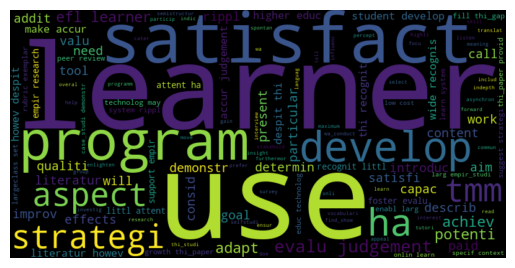

Top authors in community 148: https://openalex.org/A5054138313, https://openalex.org/A5054138313, https://openalex.org/A5054138313


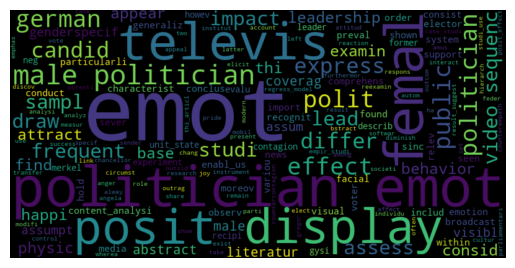

Top authors in community 149: https://openalex.org/A5035084501, https://openalex.org/A5035084501, https://openalex.org/A5035084501


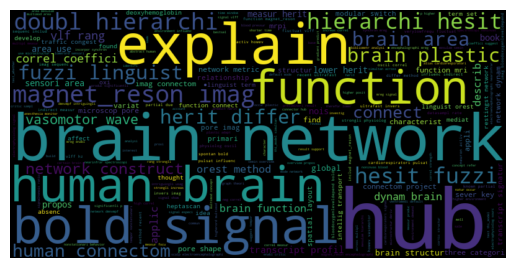

Top authors in community 150: https://openalex.org/A5032257766, https://openalex.org/A5046284320, https://openalex.org/A5036106869


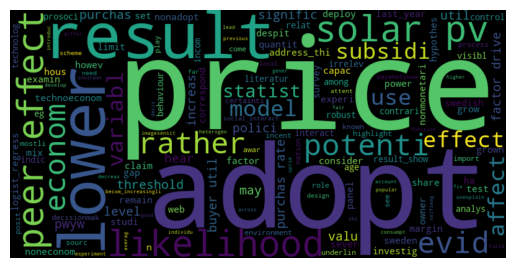

Top authors in community 151: https://openalex.org/A5064738197, https://openalex.org/A5064738197, https://openalex.org/A5079799756


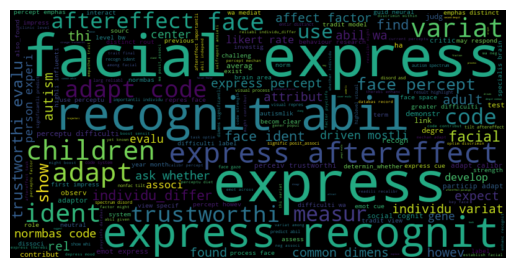

Top authors in community 152: https://openalex.org/A5021955713, https://openalex.org/A5021955713, https://openalex.org/A5021955713


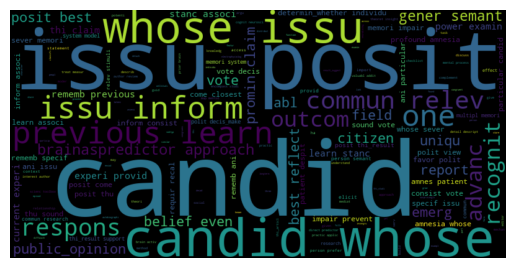

Top authors in community 153: https://openalex.org/A5051210012, https://openalex.org/A5004733065, https://openalex.org/A5039159288


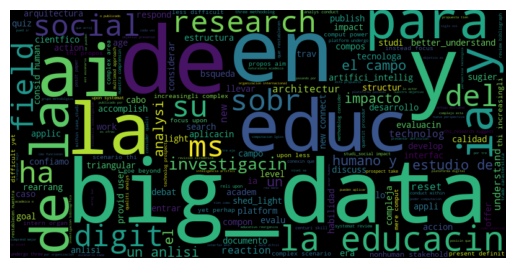

Top authors in community 154: https://openalex.org/A5012434331, https://openalex.org/A5012434331, https://openalex.org/A5012434331


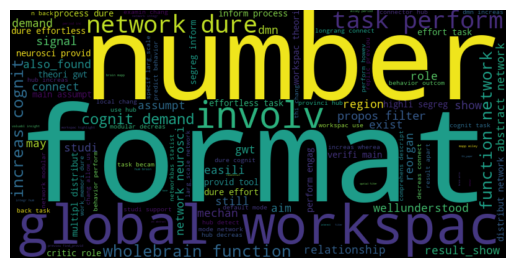

Top authors in community 155: https://openalex.org/A5072574591, https://openalex.org/A5072574591, https://openalex.org/A5061324721


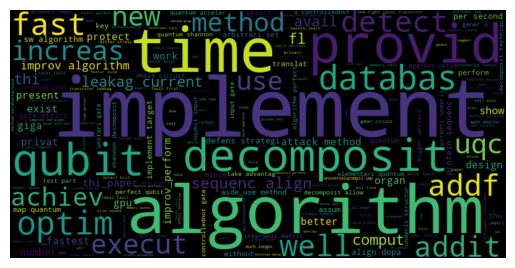

Top authors in community 156: https://openalex.org/A5066089123, https://openalex.org/A5066089123, https://openalex.org/A5066089123


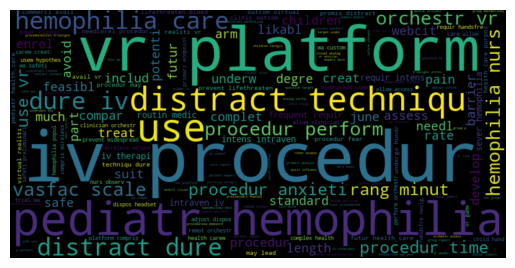

Top authors in community 157: https://openalex.org/A5055757510, https://openalex.org/A5055757510, https://openalex.org/A5055757510


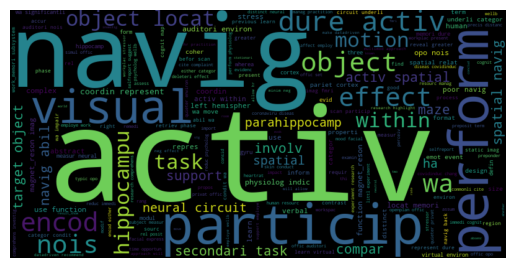

Top authors in community 158: https://openalex.org/A5007675088, https://openalex.org/A5007675088, https://openalex.org/A5007675088


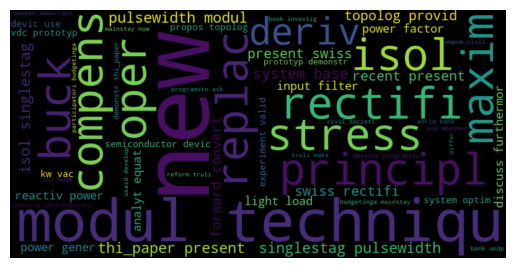

Top authors in community 159: https://openalex.org/A5061970875, https://openalex.org/A5061970875, https://openalex.org/A5061970875


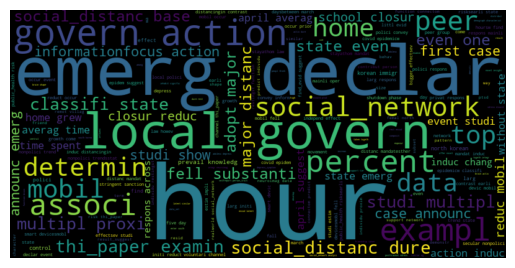

Top authors in community 160: https://openalex.org/A5046328006, https://openalex.org/A5046328006, https://openalex.org/A5046328006


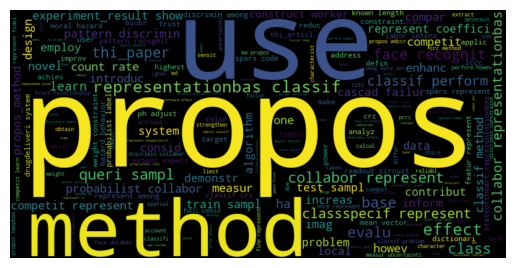

Top authors in community 161: https://openalex.org/A5047250646, https://openalex.org/A5087671511, https://openalex.org/A5073837806


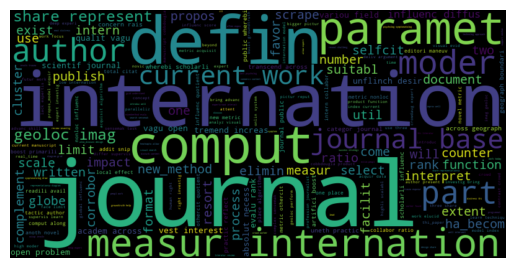

Top authors in community 162: https://openalex.org/A5014330688, https://openalex.org/A5000963442, https://openalex.org/A5040442974


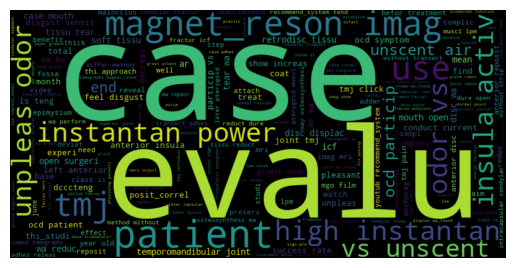

Top authors in community 163: https://openalex.org/A5028701322, https://openalex.org/A5028701322, https://openalex.org/A5028701322


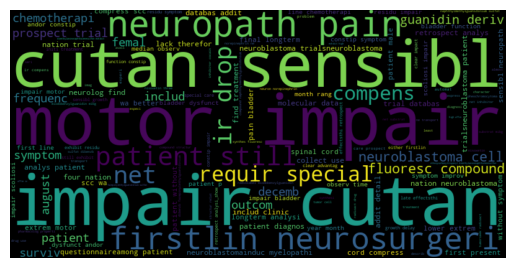

Top authors in community 164: https://openalex.org/A5085415365, https://openalex.org/A5085415365, https://openalex.org/A5085415365


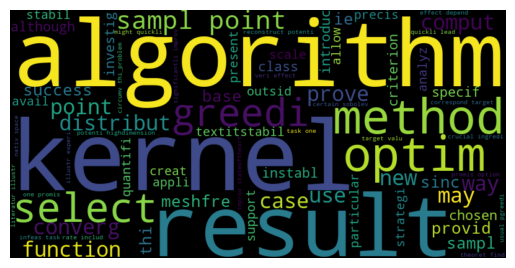

Top authors in community 165: https://openalex.org/A5042605780, https://openalex.org/A5042605780, https://openalex.org/A5042605780


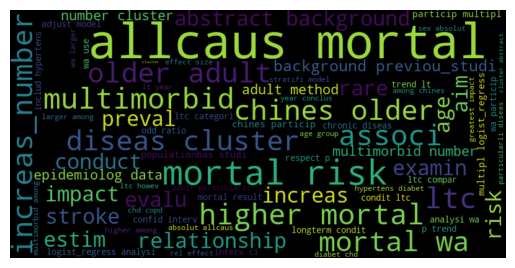

Top authors in community 166: https://openalex.org/A5054642987, https://openalex.org/A5054642987, https://openalex.org/A5054642987


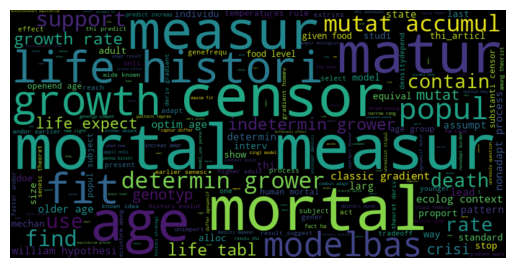

Top authors in community 167: https://openalex.org/A5053148541, https://openalex.org/A5053148541, https://openalex.org/A5038446603


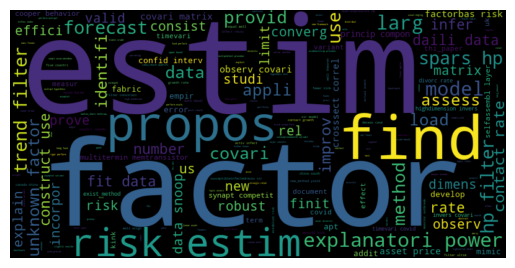

Top authors in community 168: https://openalex.org/A5058488234, https://openalex.org/A5013698019, https://openalex.org/A5017836070


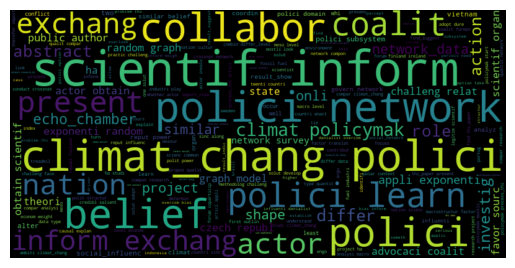

Top authors in community 169: https://openalex.org/A5042391987, https://openalex.org/A5042391987, https://openalex.org/A5042391987


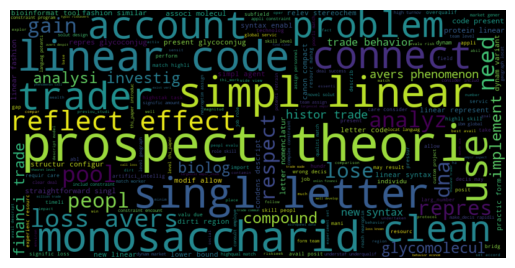

Top authors in community 170: https://openalex.org/A5044146621, https://openalex.org/A5020110225, https://openalex.org/A5023199318


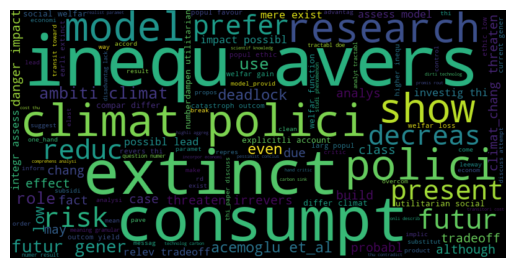

Top authors in community 171: https://openalex.org/A5046955571, https://openalex.org/A5046955571, https://openalex.org/A5046955571


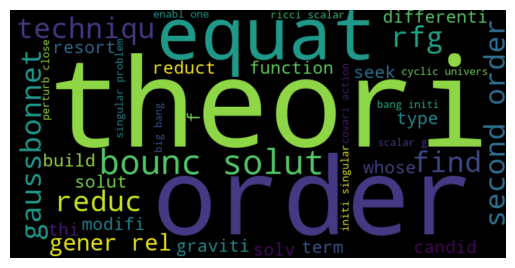

Top authors in community 172: https://openalex.org/A5001559036, https://openalex.org/A5088392939, https://openalex.org/A5089384499


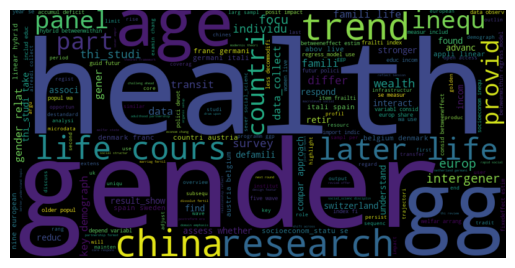

Top authors in community 173: https://openalex.org/A5032278939, https://openalex.org/A5032278939, https://openalex.org/A5032278939


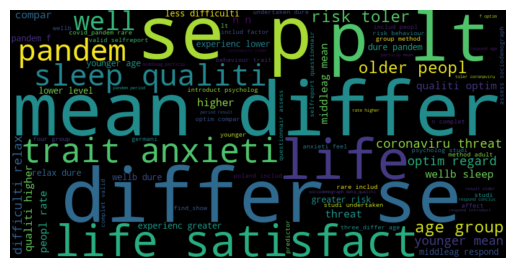

Top authors in community 174: https://openalex.org/A5025069859, https://openalex.org/A5035407958, https://openalex.org/A5036057602


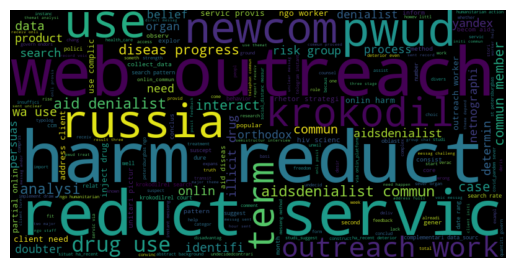

Top authors in community 175: https://openalex.org/A5009614805, https://openalex.org/A5008813157, https://openalex.org/A5002702320


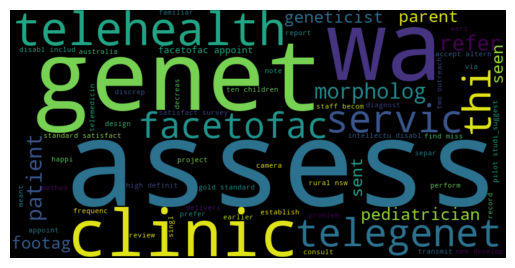

Top authors in community 176: https://openalex.org/A5057360766, https://openalex.org/A5007077429


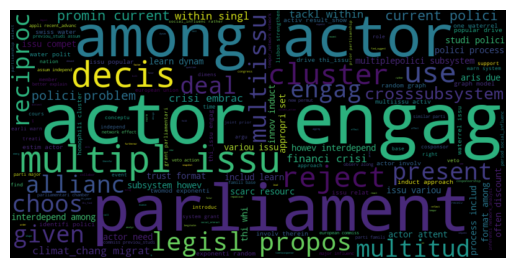

Top authors in community 177: https://openalex.org/A5054501501, https://openalex.org/A5057645839, https://openalex.org/A5051062688


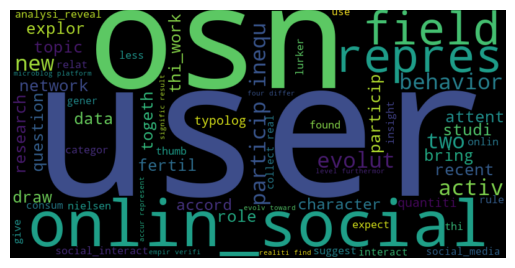

Top authors in community 178: https://openalex.org/A5009541437, https://openalex.org/A5045947853, https://openalex.org/A5090115852


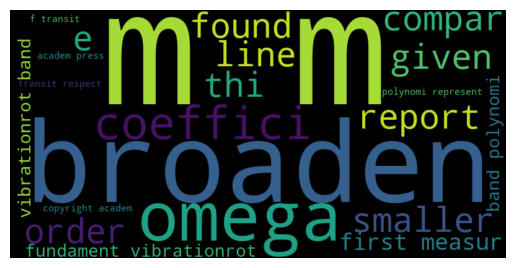

Top authors in community 179: https://openalex.org/A5064171835, https://openalex.org/A5064171835, https://openalex.org/A5064171835


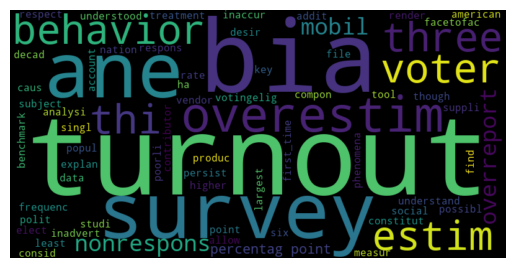

Top authors in community 180: https://openalex.org/A5068713525, https://openalex.org/A5068713525, https://openalex.org/A5068713525


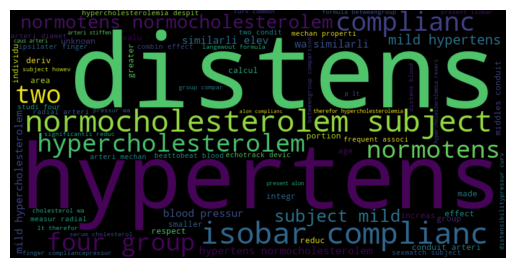

Top authors in community 181: https://openalex.org/A5052905268, https://openalex.org/A5052905268, https://openalex.org/A5052905268


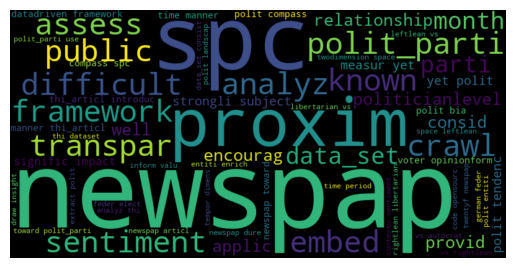

Top authors in community 182: https://openalex.org/A5062103492, https://openalex.org/A5062103492, https://openalex.org/A5084860941


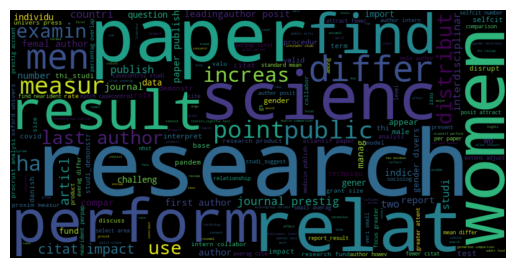

Top authors in community 183: https://openalex.org/A5003546846, https://openalex.org/A5003546846, https://openalex.org/A5080335789


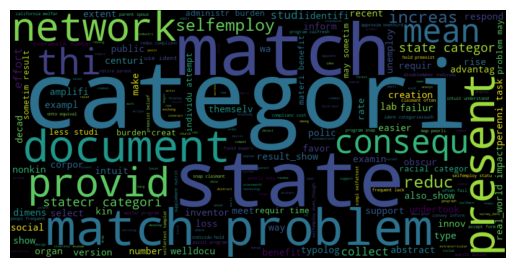

Top authors in community 184: https://openalex.org/A5010053907, https://openalex.org/A5010053907, https://openalex.org/A5010053907


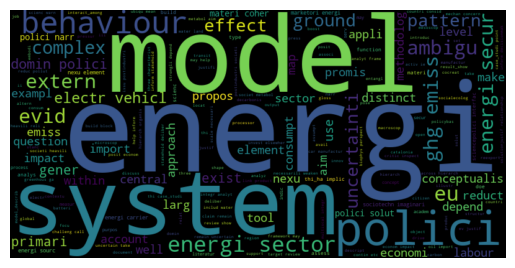

Top authors in community 185: https://openalex.org/A5068251706, https://openalex.org/A5068251706, https://openalex.org/A5068251706


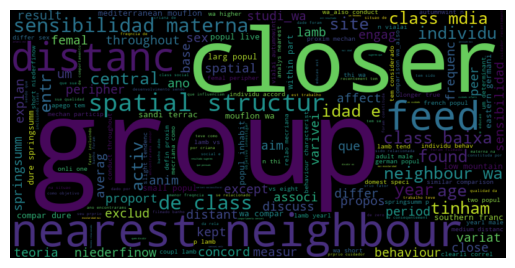

Top authors in community 186: https://openalex.org/A5034089601, https://openalex.org/A5034089601, https://openalex.org/A5011283595


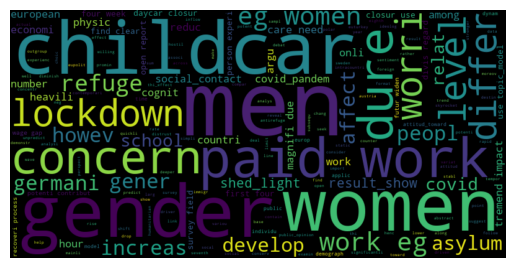

Top authors in community 187: https://openalex.org/A5034869512, https://openalex.org/A5073745340, https://openalex.org/A5073745340


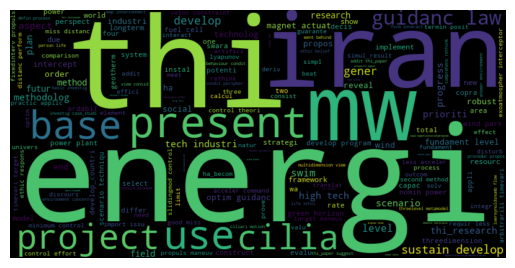

Top authors in community 188: https://openalex.org/A5065320504, https://openalex.org/A5065320504, https://openalex.org/A5065320504


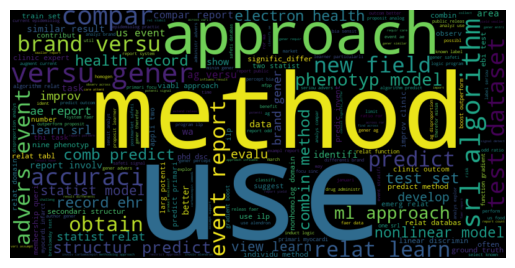

Top authors in community 189: https://openalex.org/A5090619385, https://openalex.org/A5090619385, https://openalex.org/A5090619385


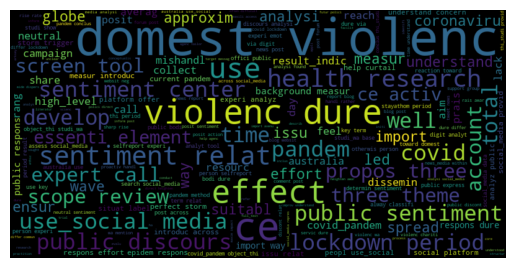

Top authors in community 190: https://openalex.org/A5089951210, https://openalex.org/A5089951210, https://openalex.org/A5081107769


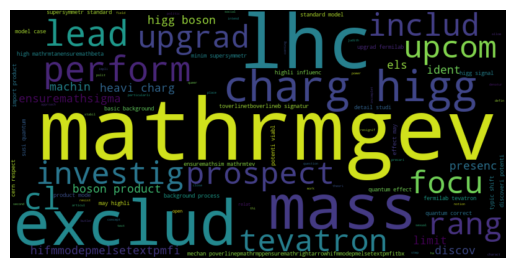

Top authors in community 191: https://openalex.org/A5035786206, https://openalex.org/A5035786206, https://openalex.org/A5008759018


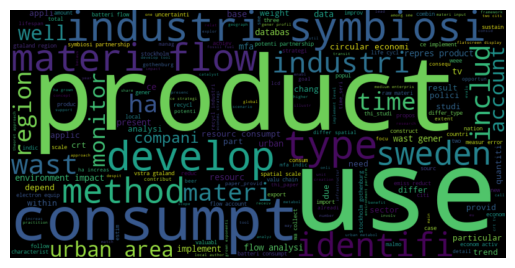

Top authors in community 192: https://openalex.org/A5039256697, https://openalex.org/A5039256697, https://openalex.org/A5039256697


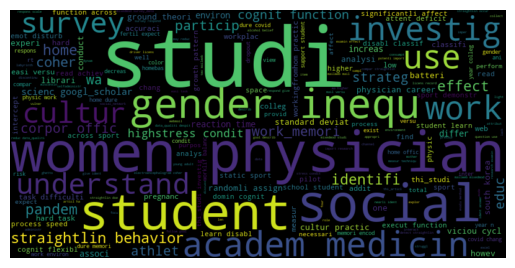

Top authors in community 193: https://openalex.org/A5074208278, https://openalex.org/A5074208278, https://openalex.org/A5074208278


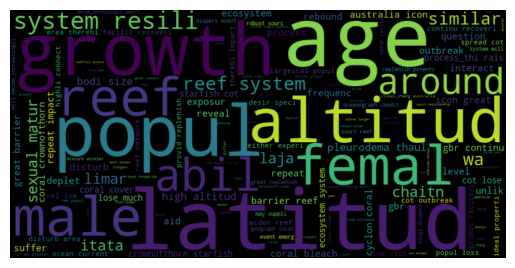

Top authors in community 194: https://openalex.org/A5049262683, https://openalex.org/A5049262683, https://openalex.org/A5049262683


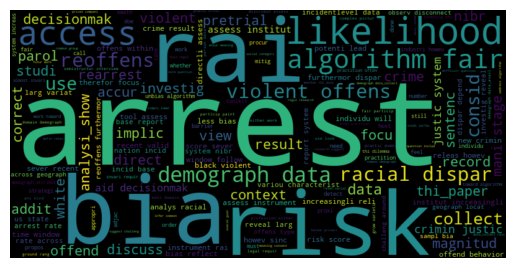

Top authors in community 195: https://openalex.org/A5069640989, https://openalex.org/A5069640989, https://openalex.org/A5090989921


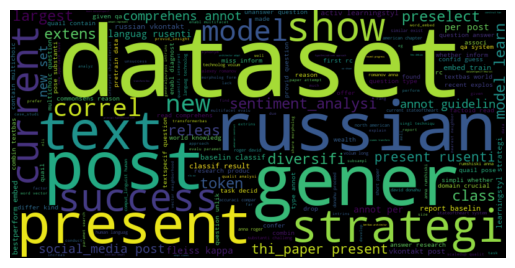

Top authors in community 196: https://openalex.org/A5071803353, https://openalex.org/A5030374143, https://openalex.org/A5002408562


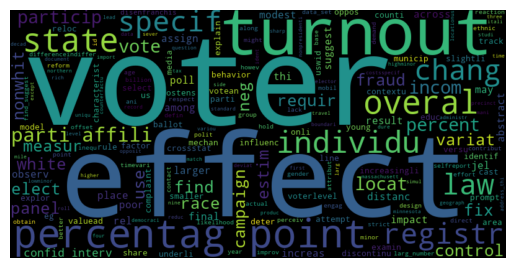

Top authors in community 197: https://openalex.org/A5050902528, https://openalex.org/A5050902528, https://openalex.org/A5050902528


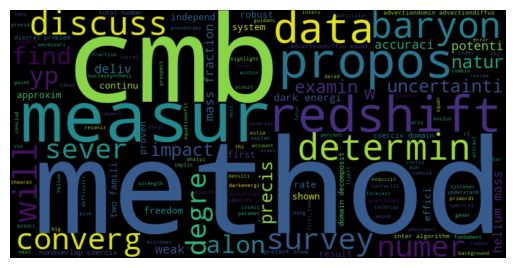

Top authors in community 198: https://openalex.org/A5057252498, https://openalex.org/A5057252498, https://openalex.org/A5070367582


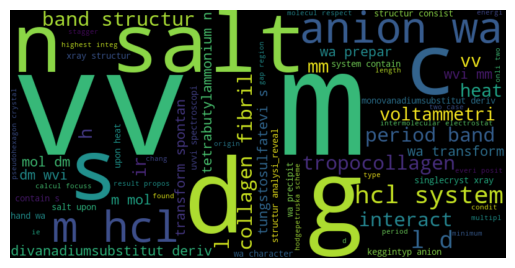

Top authors in community 199: https://openalex.org/A5077745776, https://openalex.org/A5077745776, https://openalex.org/A5023832609


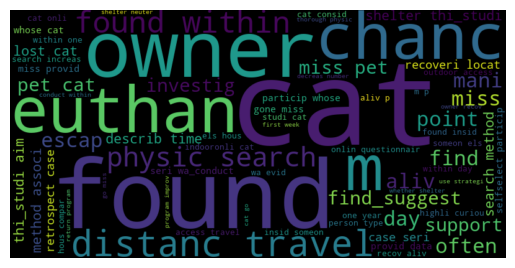

Top authors in community 200: https://openalex.org/A5040000503, https://openalex.org/A5040000503, https://openalex.org/A5040000503


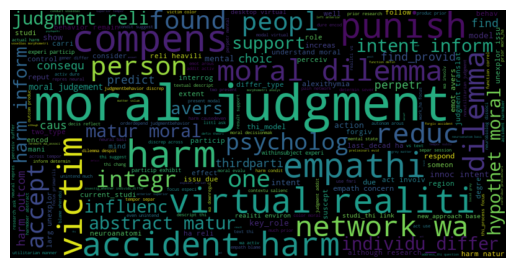

Top authors in community 201: https://openalex.org/A5043752696, https://openalex.org/A5043752696, https://openalex.org/A5043752696


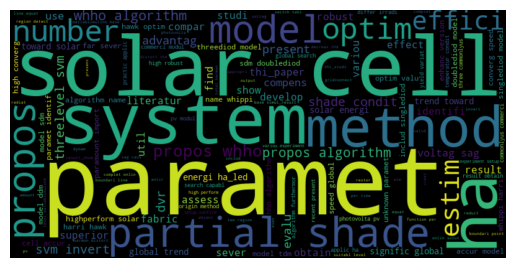

Top authors in community 202: https://openalex.org/A5019800917, https://openalex.org/A5066136171, https://openalex.org/A5085138903


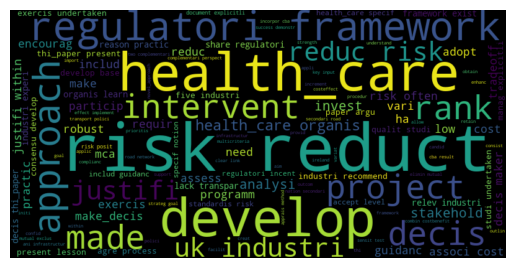

Top authors in community 203: https://openalex.org/A5067094699, https://openalex.org/A5014750522, https://openalex.org/A5021614922


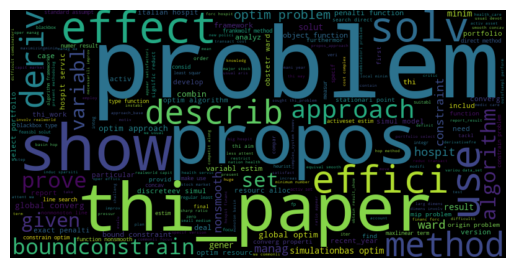

Top authors in community 204: https://openalex.org/A5047545433, https://openalex.org/A5044875858, https://openalex.org/A5019373396


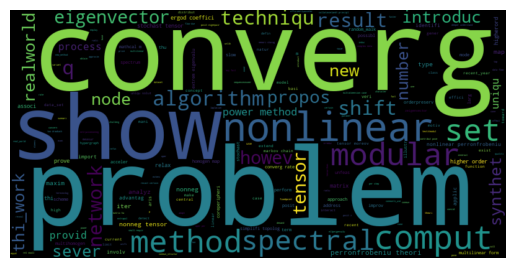

Top authors in community 205: https://openalex.org/A5034693159, https://openalex.org/A5034693159, https://openalex.org/A5034693159


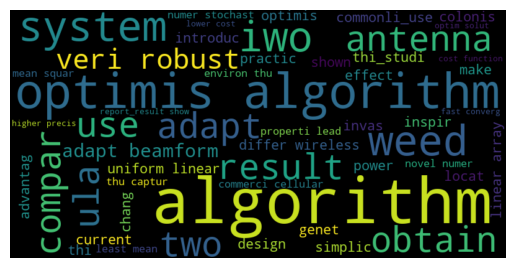

Top authors in community 206: https://openalex.org/A5039114051, https://openalex.org/A5039114051, https://openalex.org/A5039114051


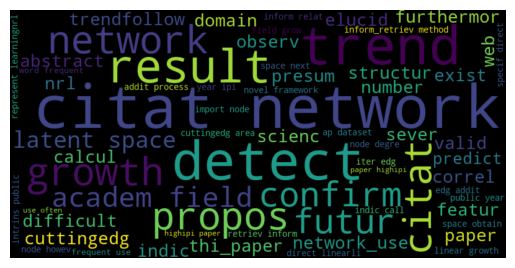

Top authors in community 207: https://openalex.org/A5058502061, https://openalex.org/A5039966234, https://openalex.org/A5057261458


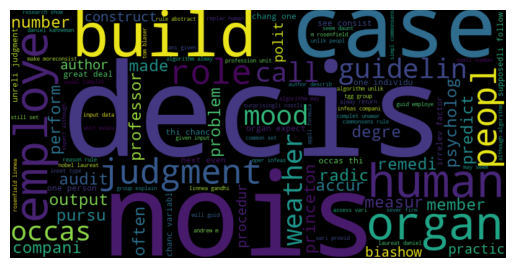

Top authors in community 208: https://openalex.org/A5085714892, https://openalex.org/A5085714892, https://openalex.org/A5085714892


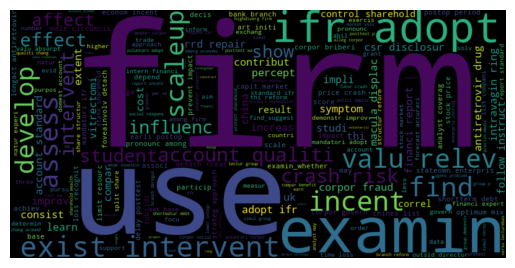

Top authors in community 209: https://openalex.org/A5084267145, https://openalex.org/A5084267145, https://openalex.org/A5084267145


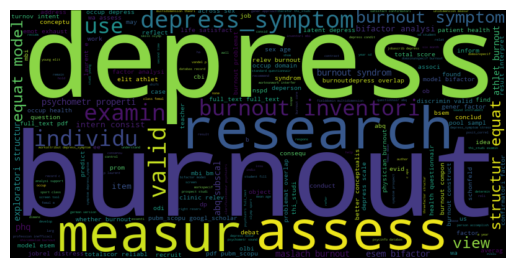

Top authors in community 210: https://openalex.org/A5088552439, https://openalex.org/A5027023070, https://openalex.org/A5053334802


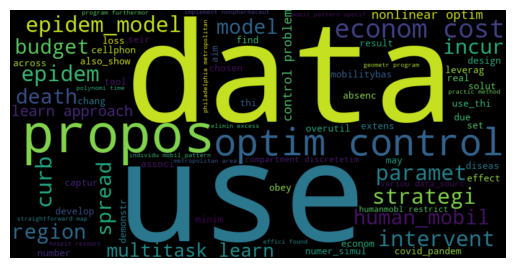

Top authors in community 211: https://openalex.org/A5030664816, https://openalex.org/A5029225859


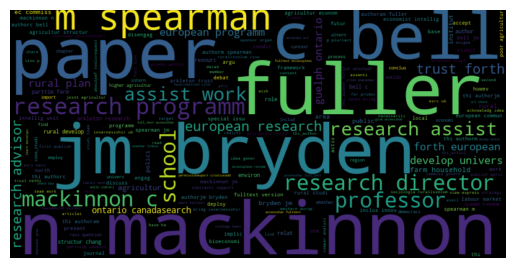

Top authors in community 212: https://openalex.org/A5056467893, https://openalex.org/A5056467893, https://openalex.org/A5056467893


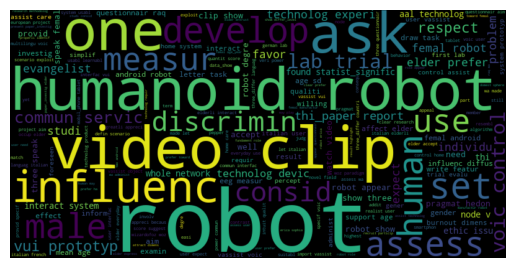

Top authors in community 213: https://openalex.org/A5043251311, https://openalex.org/A5043251311, https://openalex.org/A5043251311


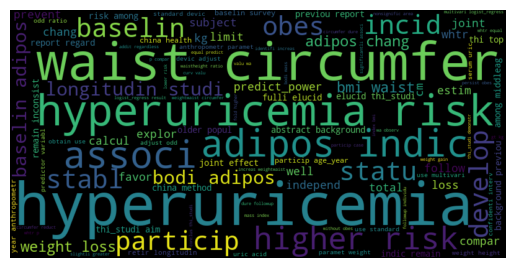

Top authors in community 214: https://openalex.org/A5007626204, https://openalex.org/A5007626204, https://openalex.org/A5007626204


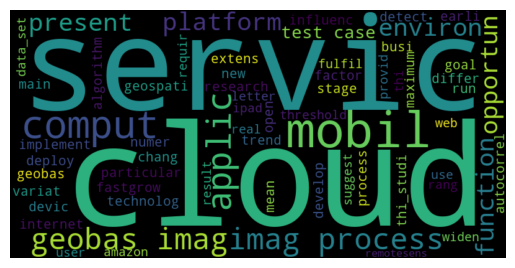

Top authors in community 215: https://openalex.org/A5021205874, https://openalex.org/A5045412540, https://openalex.org/A5090031720


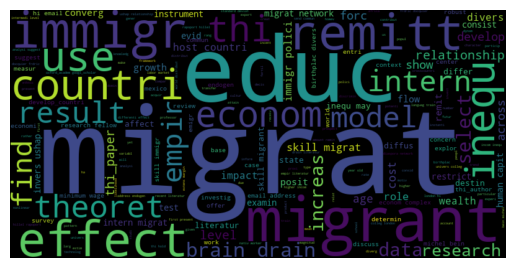

Top authors in community 216: https://openalex.org/A5030340672, https://openalex.org/A5030340672, https://openalex.org/A5078430868


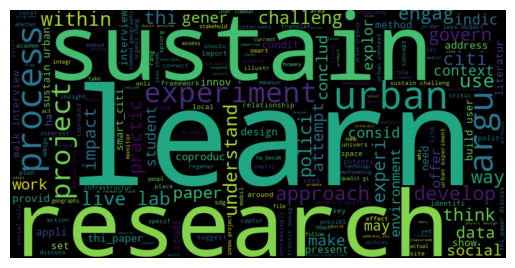

Top authors in community 217: https://openalex.org/A5050485733, https://openalex.org/A5050485733, https://openalex.org/A5050485733


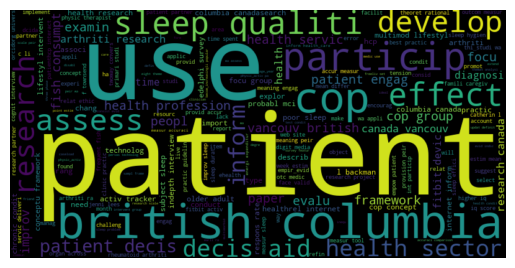

Top authors in community 218: https://openalex.org/A5045925919, https://openalex.org/A5045925919, https://openalex.org/A5081217749


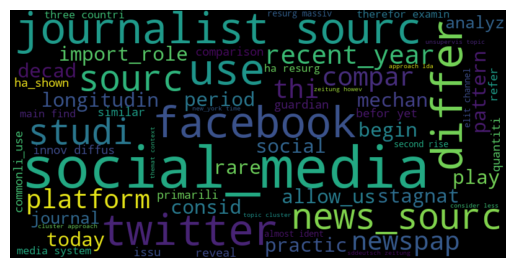

Top authors in community 219: https://openalex.org/A5014026767, https://openalex.org/A5066195010, https://openalex.org/A5075356239


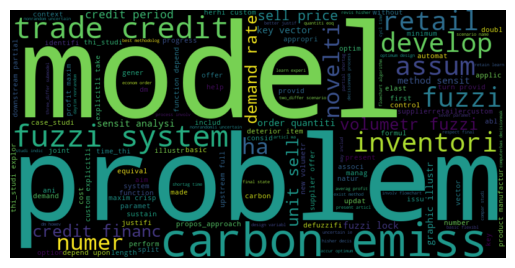

Top authors in community 220: https://openalex.org/A5037479075, https://openalex.org/A5037479075, https://openalex.org/A5049055745


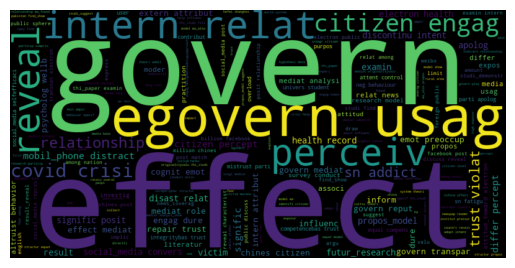

Top authors in community 221: https://openalex.org/A5028306705, https://openalex.org/A5028306705, https://openalex.org/A5028306705


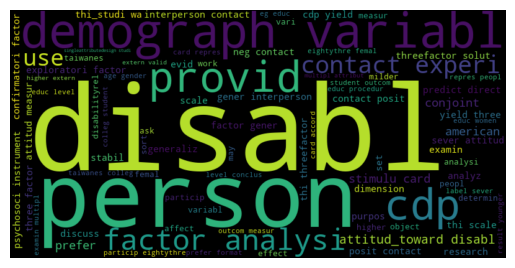

Top authors in community 222: https://openalex.org/A5063325475, https://openalex.org/A5063325475, https://openalex.org/A5063325475


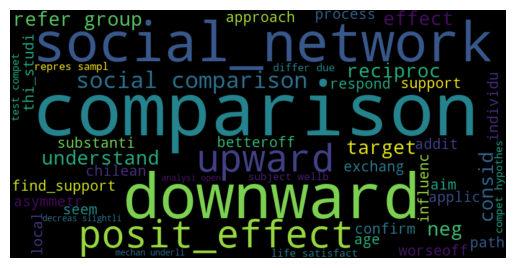

Top authors in community 223: https://openalex.org/A5071088094, https://openalex.org/A5071088094, https://openalex.org/A5071088094


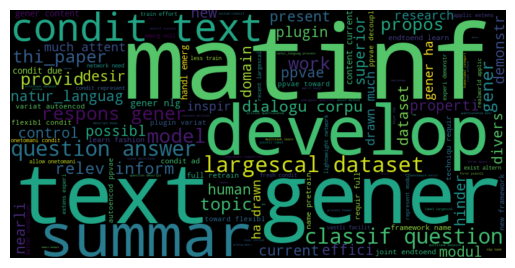

Top authors in community 224: https://openalex.org/A5042614566, https://openalex.org/A5087452627, https://openalex.org/A5058340908


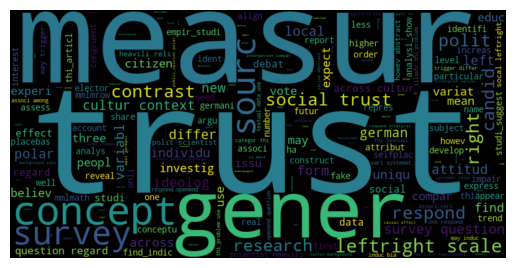

Top authors in community 225: https://openalex.org/A5084222212, https://openalex.org/A5084222212, https://openalex.org/A5084222212


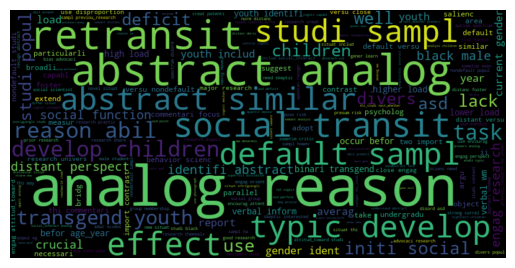

Top authors in community 226: https://openalex.org/A5032934166, https://openalex.org/A5032934166, https://openalex.org/A5032934166


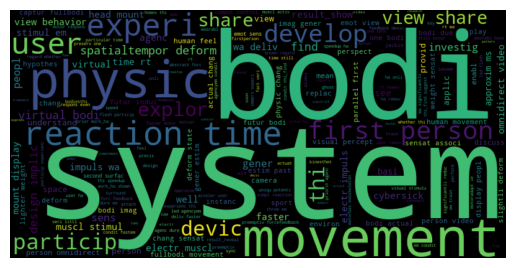

Top authors in community 227: https://openalex.org/A5054887365, https://openalex.org/A5054887365, https://openalex.org/A5054887365


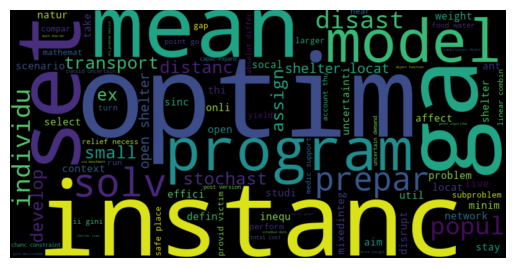

Top authors in community 228: https://openalex.org/A5033830347, https://openalex.org/A5033830347, https://openalex.org/A5033830347


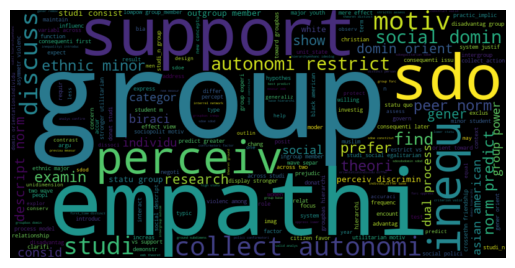

Top authors in community 230: https://openalex.org/A5033299992, https://openalex.org/A5033299992, https://openalex.org/A5072999287


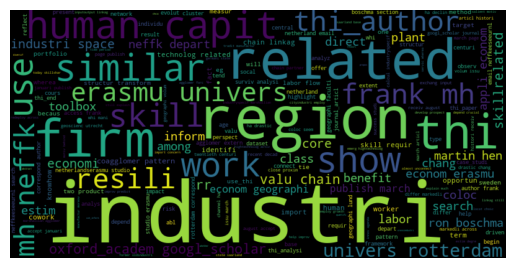

Top authors in community 231: https://openalex.org/A5008800832, https://openalex.org/A5008800832, https://openalex.org/A5008800832


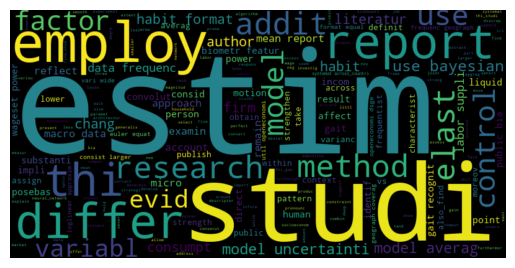

Top authors in community 232: https://openalex.org/A5028956216, https://openalex.org/A5068416688, https://openalex.org/A5088653510


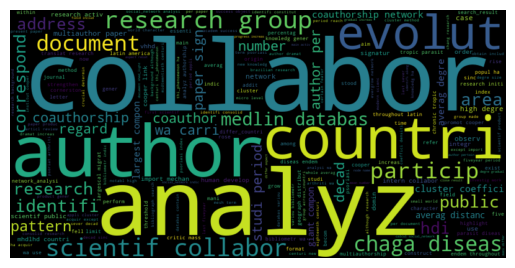

Top authors in community 233: https://openalex.org/A5037441540, https://openalex.org/A5037441540, https://openalex.org/A5037441540


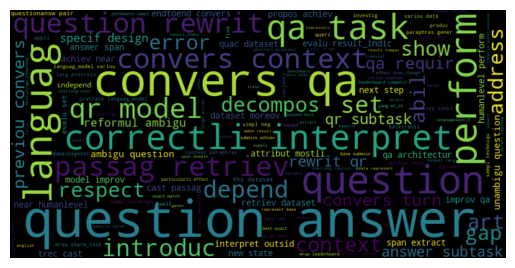

Top authors in community 234: https://openalex.org/A5082225935, https://openalex.org/A5082225935, https://openalex.org/A5082225935


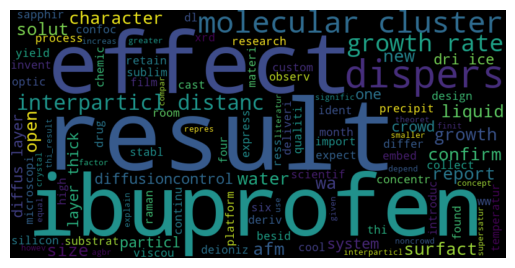

Top authors in community 235: https://openalex.org/A5000747784, https://openalex.org/A5000747784, https://openalex.org/A5000747784


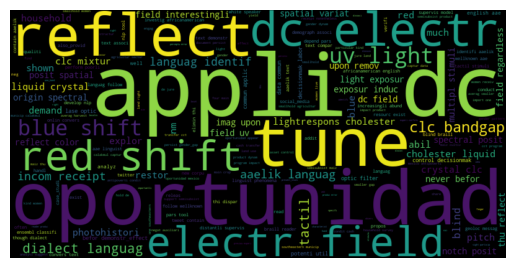

Top authors in community 236: https://openalex.org/A5063339619, https://openalex.org/A5063339619, https://openalex.org/A5063339619


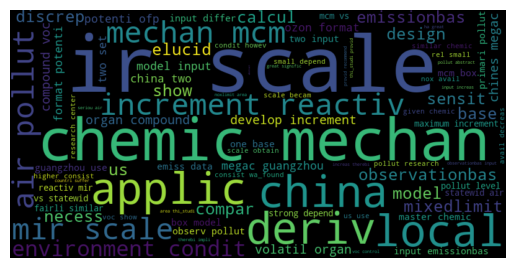

Top authors in community 237: https://openalex.org/A5044809751, https://openalex.org/A5042728295, https://openalex.org/A5048041198


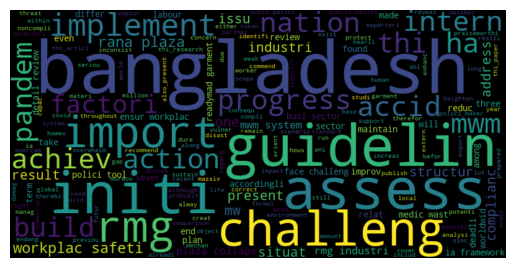

Top authors in community 238: https://openalex.org/A5017878990, https://openalex.org/A5059686529, https://openalex.org/A5051226686


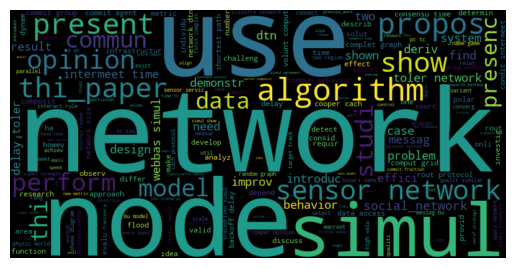

Top authors in community 239: https://openalex.org/A5066694574, https://openalex.org/A5059171727


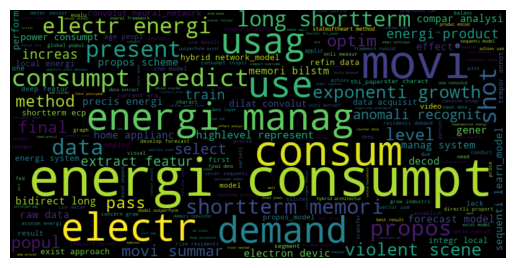

Top authors in community 240: https://openalex.org/A5047810054, https://openalex.org/A5047810054, https://openalex.org/A5002710722


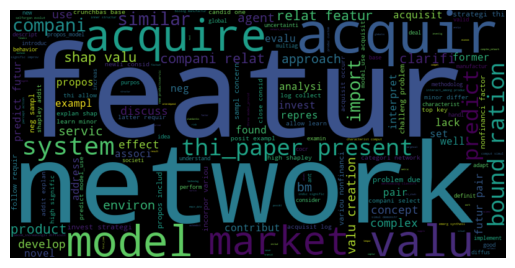

Top authors in community 241: https://openalex.org/A5052710947, https://openalex.org/A5052710947, https://openalex.org/A5052710947


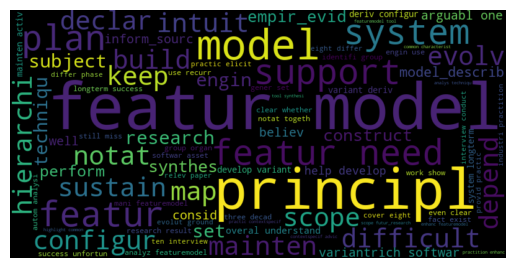

Top authors in community 242: https://openalex.org/A5018151279, https://openalex.org/A5018151279, https://openalex.org/A5018151279


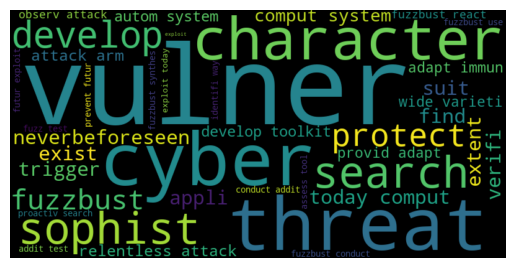

Top authors in community 243: https://openalex.org/A5084459940, https://openalex.org/A5084459940, https://openalex.org/A5084459940


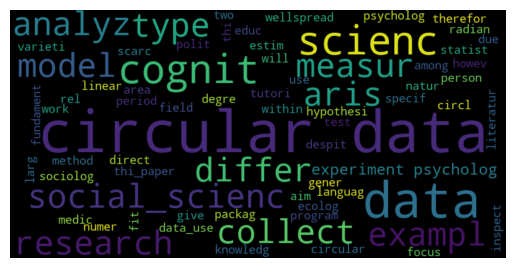

Top authors in community 244: https://openalex.org/A5012506346, https://openalex.org/A5054504492, https://openalex.org/A5079180422


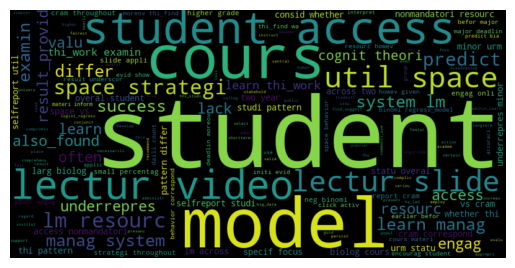

Top authors in community 245: https://openalex.org/A5056168765, https://openalex.org/A5056168765, https://openalex.org/A5002616081


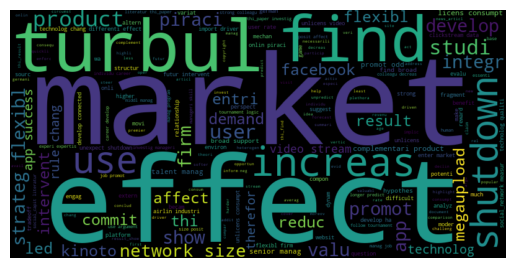

Top authors in community 246: https://openalex.org/A5074781940, https://openalex.org/A5077289750, https://openalex.org/A5038562202


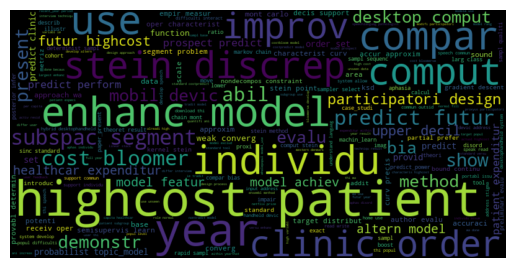

Top authors in community 247: https://openalex.org/A5041231901, https://openalex.org/A5051692037, https://openalex.org/A5045922841


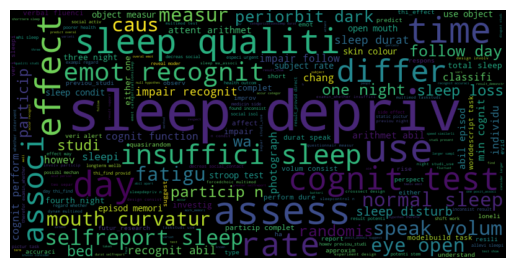

Top authors in community 248: https://openalex.org/A5064910304, https://openalex.org/A5064910304, https://openalex.org/A5064910304


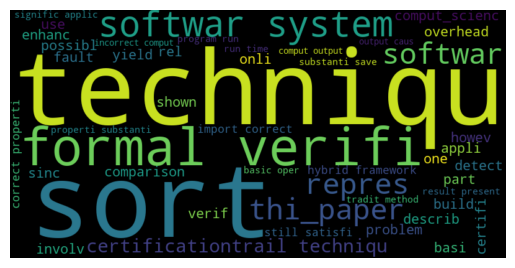

Top authors in community 249: https://openalex.org/A5078399314, https://openalex.org/A5078399314, https://openalex.org/A5066039364


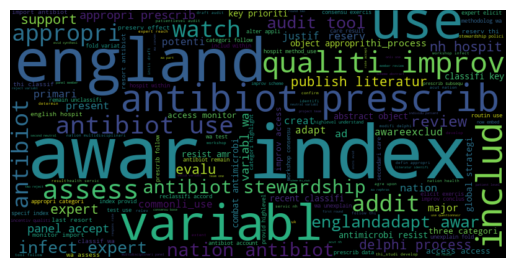

Top authors in community 250: https://openalex.org/A5007839126, https://openalex.org/A5036047084, https://openalex.org/A5040310678


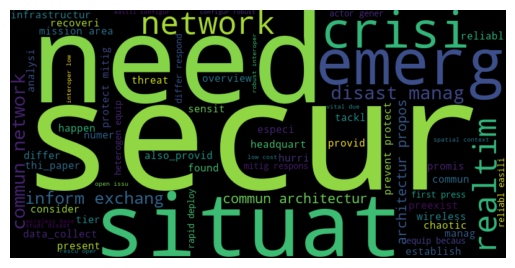

Top authors in community 251: https://openalex.org/A5001855584, https://openalex.org/A5050042134, https://openalex.org/A5091669275


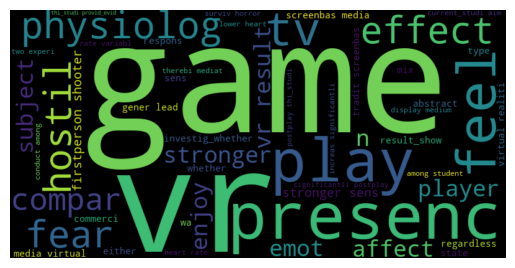

Top authors in community 252: https://openalex.org/A5028858881, https://openalex.org/A5028858881, https://openalex.org/A5028858881


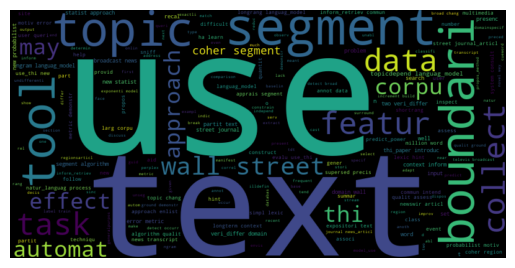

Top authors in community 253: https://openalex.org/A5019172487, https://openalex.org/A5019172487, https://openalex.org/A5019172487


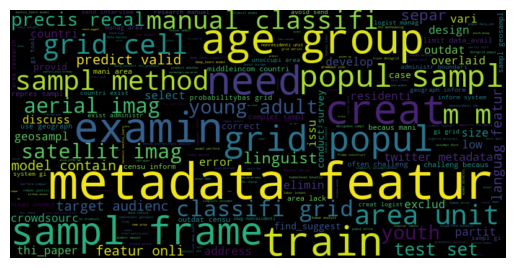

Top authors in community 254: https://openalex.org/A5047436850, https://openalex.org/A5047436850, https://openalex.org/A5047436850


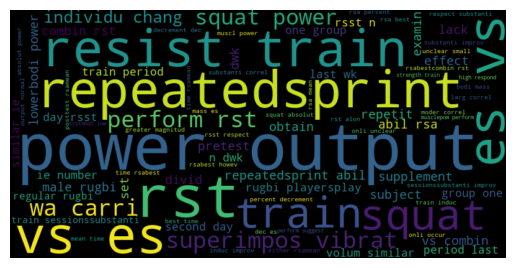

Top authors in community 255: https://openalex.org/A5062068291, https://openalex.org/A5062068291, https://openalex.org/A5062068291


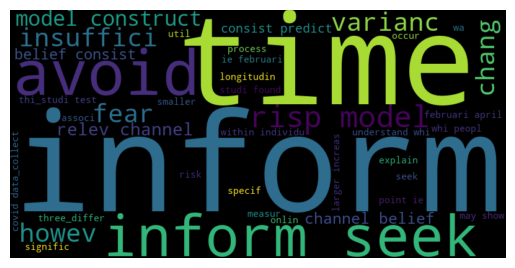

Top authors in community 256: https://openalex.org/A5080267104, https://openalex.org/A5080267104, https://openalex.org/A5080267104


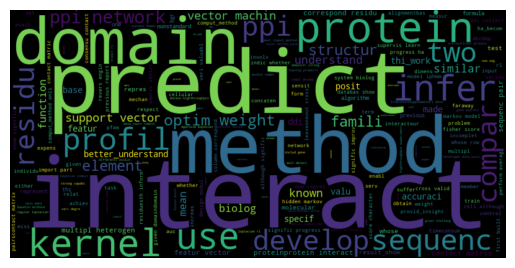

Top authors in community 257: https://openalex.org/A5034295818, https://openalex.org/A5034295818, https://openalex.org/A5079294098


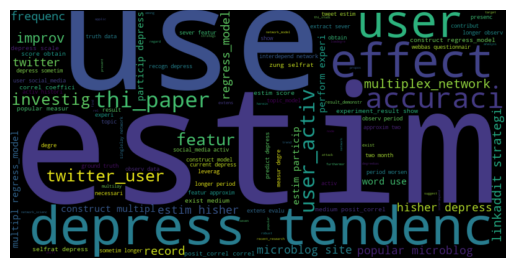

Top authors in community 258: https://openalex.org/A5032514633, https://openalex.org/A5068070625, https://openalex.org/A5022073192


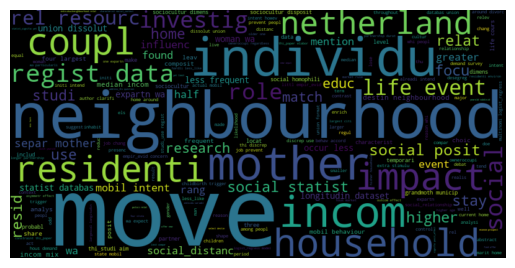

Top authors in community 259: https://openalex.org/A5073588329, https://openalex.org/A5073588329, https://openalex.org/A5073588329


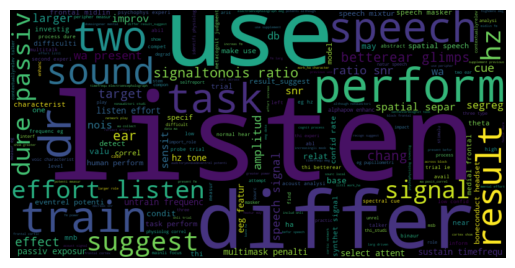

Top authors in community 260: https://openalex.org/A5076021081, https://openalex.org/A5076021081, https://openalex.org/A5076021081


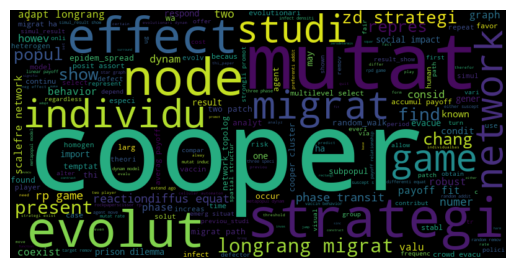

Top authors in community 261: https://openalex.org/A5016819382, https://openalex.org/A5016819382, https://openalex.org/A5075314395


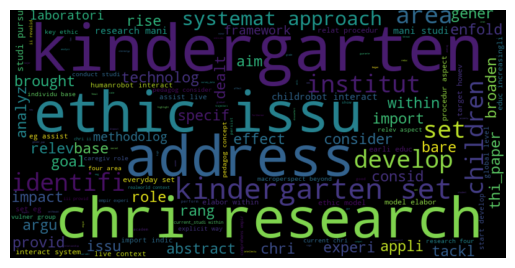

Top authors in community 262: https://openalex.org/A5002984043, https://openalex.org/A5027682613, https://openalex.org/A5084527753


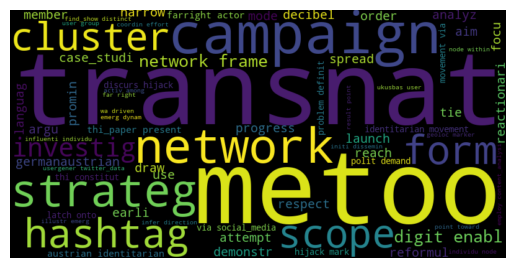

Top authors in community 263: https://openalex.org/A5023107270, https://openalex.org/A5042075947


In [32]:
for community, row in community_docs.iterrows():
    # Create a WordCloud
    wordcloud = WordCloud(width=800, height=400).generate(' '.join(row['tokens']))

    # Display the WordCloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

    # Print the names of the top three authors in the community
    top_authors = row['top_authors']
    print(f"Top authors in community {community}: {', '.join(top_authors)}")

#### Question:

Comment on your results. What can you conclude on the different sub-communities in Computational Social Science?

#### Answer:

Each communitites wordcloud is notably different from the others. This suggests that the communities are distinct from each other in terms of words and probably also in terms of content. The wordclouds provide a visual representation of the most important words in each community. The words use and model are used across a lot of communities, which suggests that these words are important in the field of computational social science.

### Exercise 3: Computational Social Science

#### Question:

Go back to Week 1, Exercise 1. Revise what you wrote on the topics in Computational Social Science.
In light of your data-driven analysis, has your understanding of the field changed? How? (max 150 words)

#### Answer:

We think we have gained a broader understanding of how the field is. The way of collecting data was fairly in line with our reflections, by creating surveys, API calls, web scraping so on. In terms of the methods used this project has broadened our perspective of how exactly these networks are constructed and the different methods used to draw information out of the results. Furthermore, we also think that the field is wider than first anticipated as we now understand we can take a social approach on almost any topic which also makes the scientist that works on these studies a very diverse group.